In [1]:
library(IRdisplay)
display_html("<style>.container { width:100% !important; }</style>")

In [2]:
suppressPackageStartupMessages(library(data.table))
suppressPackageStartupMessages(library(purrr))
suppressPackageStartupMessages(library(deMULTIplex))
suppressPackageStartupMessages(library(optparse))
suppressPackageStartupMessages(library(ggplot2))
suppressPackageStartupMessages(library(dplyr))

In [3]:
opts <- list()
opts$inputdir <- "/nfs/research/marioni/Leah/gastrulation_epigenetics/gastruloid_characterisation/data_dir/processed_files_Leah/scRNAseq/"
opts$settings <- "/nfs/research/marioni/Leah/gastrulation_epigenetics/gastruloid_characterisation/gastruloids_scRNAseq/pipeline/processing/settings.R"
opts$experiment <- "MULTI/exp4_d3"
opts$sample <- "sampleA"
source(opts$settings)

In [4]:
full_outbase <- paste0(opts$inputdir, opts$experiment, "/")
final.calls.rescued <- readRDS(paste0(full_outbase, opts$sample, "_finalCalls.rds"))
final.calls.rescued

AGACCCGAGCTGAGCA AGACCCGAGTCGCGAA AGACCCGTCAGCTCTC AGAGAATAGAGGCTGT 
          "Bar6"           "Bar6"           "Bar6"          "Bar24" 
AGAGAATAGTATTAGG AGAGAATGTTAACCTG AGAGCAGAGTCAGCCC AGAGCAGTCGAGTACT 
          "Bar6"        "Doublet"        "Doublet"          "Bar24" 
AGAGCAGTCGGACTTA AGAGCCCAGGACCCAA AGAGCCCCAATACGAA AGAGCCCGTAGAGGAA 
         "Bar12"          "Bar24"        "Doublet"           "Bar6" 
AGAGCCCTCGAAACAA AGATAGAAGTAATCCC AGATAGATCGAAGTGG AACAAGAAGACCATAA 
         "Bar12"        "Doublet"          "Bar24"        "Doublet" 
AGATCGTAGACTGAGC AGATCGTTCCTGGTCT AGATGAAAGGGAGTGG AGATGAAGTGAGGCAT 
         "Bar12"           "Bar2"          "Bar24"           "Bar6" 
AGATGCTAGCGTTAGG AGATGCTAGCTCCACG AGATGCTAGGACACTG AGATGCTAGGTTCTAC 
          "Bar6"           "Bar6"        "Doublet"          "Bar24" 
AACAAGAAGTCCCTAA AGATGCTGTCAGCTTA AGATGCTGTTCGTGCG AGATGCTTCGTTACCC 
          "Bar6"        "Doublet"          "Bar55"          "Bar24" 
AGCATCAAGTCACTGT AGCATCATCTTCCCGA AGCCACGCAGAGGTAC AACAAGACACGACAAG 
         "Bar24"           "Bar6"           "Bar6"          "Bar41" 
AGCCACGGTACGTAGG AGCCACGTCTGACAGT AGCCAGCAGTTGGCTT AACAAGACAGAGTCTT 
         "Bar24"        "Doublet"          "Bar12"          "Bar24" 
AGCGATTCAGTCGGTC AGCGATTGTATCGCTA AGCGCCAGTGAGGCAT AGCGCCATCTATGTGG 
         "Bar24"          "Bar24"          "Bar25"           "Bar6" 
AGCGTATAGTCGAAGC AGCGTATGTGGCTTGC AGCGTCGCACAGCTGC AACAAGATCGGTAGGA 
          "Bar6"        "Doublet"          "Bar12"           "Bar6" 
AGCTACACACACGGAA AGCTACATCTTGGCTC AGCTCAACAACCCGCA AGCTCAATCGTGGGAA 
         "Bar12"        "Doublet"           "Bar6"          "Bar12" 
AGCTCAATCTTTGGAG AACACACAGGCCACCT AGGAAATCACACGGTC AGGAAATGTTGGGTAG 
         "Bar12"        "Doublet"           "Bar6"           "Bar6" 
AGGAATACACACACGC AGGAATAGTCATTCCC AACACACTCTACTGAG AGGACGACATAATGCC 
         "Bar12"           "Bar6"        "Doublet"           "Bar6" 
AGGACTTAGGTAGCCA AGGACTTCATCCCACT AGGACTTTCCAGTGCG AGGAGGTCAATCGCAT 
         "Bar24"        "Doublet"          "Bar12"          "Bar12" 
AGGAGGTTCGTAGGGA AGGAGGTTCTGGTGGC AGGATAAGTCGCTTGG AGGATAATCAGGGTAG 
         "Bar24"        "Doublet"          "Bar12"           "Bar6" 
AACAGGGCATGTCGTA AGGATCTCACACGCCA AGGATCTGTGTGCCTG AGGATCTTCCTCACTG 
       "Doublet"        "Doublet"        "Doublet"          "Bar24" 
AGGATCTTCTCTAGGA AGGATCTTCTTGAGCA AGGCATTGTAGATCGG AGGCATTGTCCCTGAG 
         "Bar24"          "Bar12"           "Bar6"          "Bar12" 
AGGCATTGTCGCTTGG AGGCATTGTTCCCACT AGGCCACAGCAGTACG AGGCCACGTTTAGTCG 
          "Bar6"        "Doublet"        "Doublet"           "Bar2" 
AACCAACAGCGACTAG AGGCTGCAGGAGGTTC AGGCTGCAGTCACACT AGGCTGCGTGTCCTAA 
         "Bar12"          "Bar24"           "Bar6"        "Doublet" 
AGGGAGTCAGCACAGA AACCAACAGTCGGCAA AGGGAGTTCGGCTTGG AGGGCCTAGTAGAGTT 
       "Doublet"          "Bar12"        "Doublet"           "Bar6" 
AGGGCTCAGAAACTGT AGGGCTCAGAGTCTGG AGGGCTCCAAGGTCAG AGGGCTCCATCCTGTC 
          "Bar6"        "Doublet"           "Bar6"        "Doublet" 
AGGGCTCGTTGTGGCC AGGGCTCGTTTCACTT AGGGCTCTCAAGTGGG AGGGTCCGTATCAGCT 
          "Bar6"          "Bar12"        "Doublet"           "Bar6" 
AACCAACCAGACCTAT AGGGTGAAGGCACGAT AGGGTGAAGGTAAACT AGGGTGAAGTAAGGGA 
          "Bar6"          "Bar66"          "Bar12"          "Bar65" 
AGGGTGACATAGACTC AACCAACCAGCAGTAG AGGGTTTAGTAGGTTA AGGGTTTTCCTGGGTG 
       "Doublet"        "Doublet"          "Bar24"          "Bar24" 
AGGTAGGAGATAGTCA AGGTAGGAGCAGGCAT AACCAACCAGTGGTGA AGGTAGGCAGACCTAT 
          "Bar6"          "Bar24"          "Bar24"          "Bar24" 
AGGTAGGCAGGCTCTG AGGTCATAGGTCACAG AACCAACCATCGTCCT AGGTCTATCAATCCAG 
         "Bar24"          "Bar24"           "Bar6"        "Doublet" 
AGGTGTTCAGTCCCGA AGGTGTTGTAACCAGG AGGTGTTGTTGTAAAG AGGTTACGTAGACGGT 
          "Bar6"          "Bar12"        "Doublet"          "Bar24" 
AGGTTACGTCGGTACC AGGTTGTAGACCGCCT AGTAACCGTCAGGTAG AGTAACCGTCGACTTA 
         "Bar24"           "Bar6"          "Bar24"          "Bar30"

In [5]:
bar.table <- readRDS(paste0(opts$inputdir,opts$experiment,"/",opts$sample,"_barTable.rds"))

In [6]:
bar.table$MULTI_class <- final.calls.rescued[rownames(bar.table)]

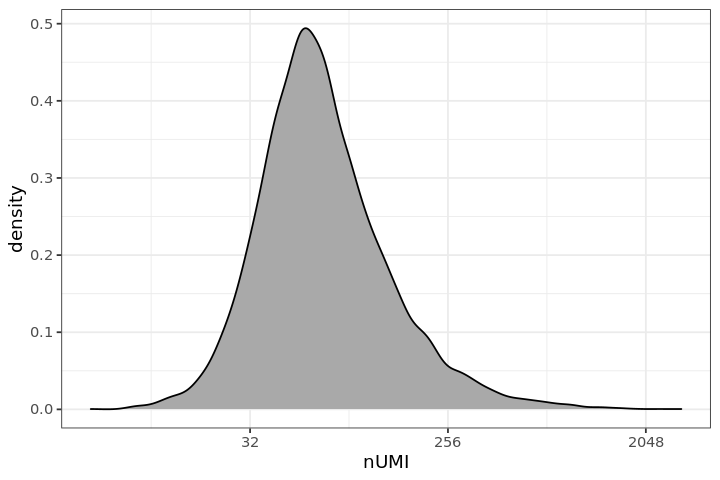

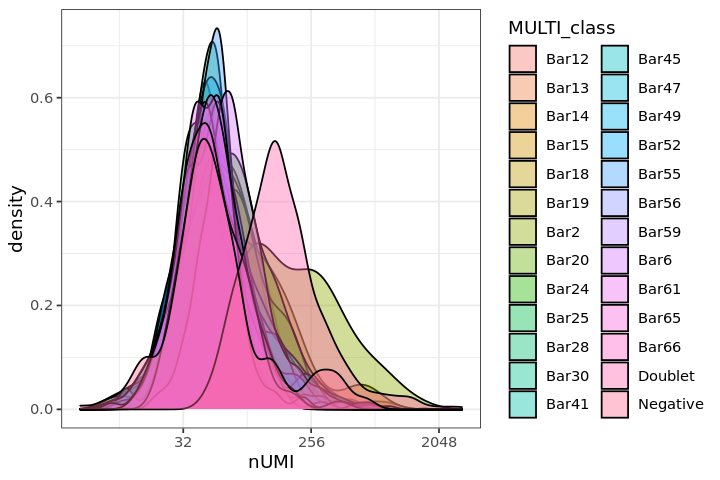

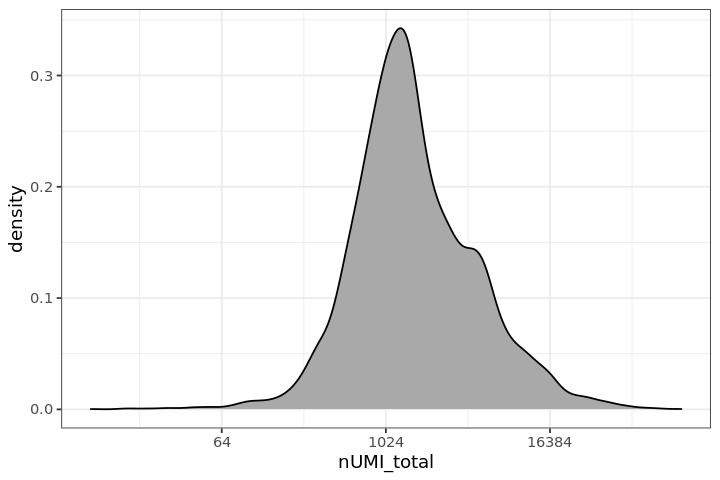

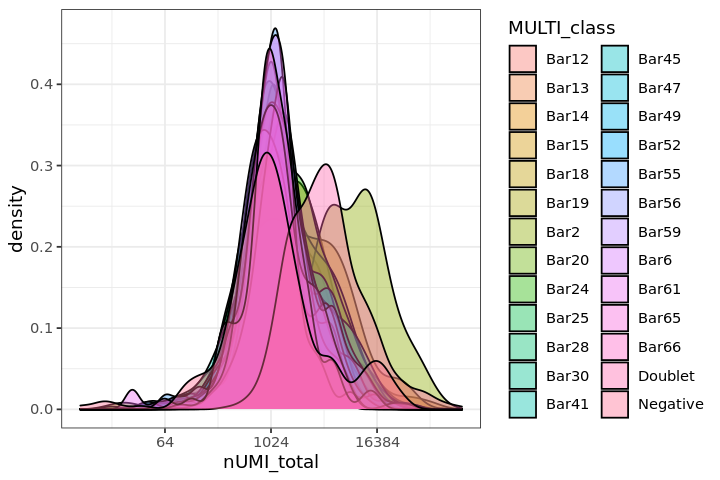

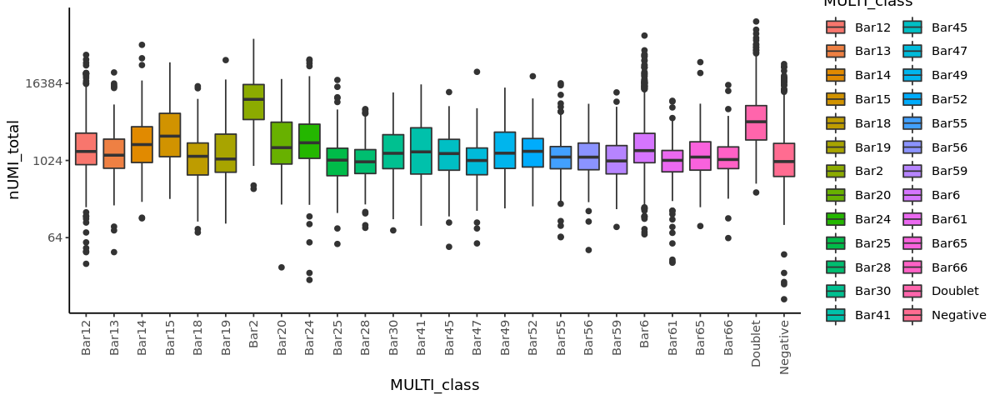

In [7]:
options(repr.plot.width=6, repr.plot.height=4)

p <- ggplot(bar.table, aes(x=nUMI)) +
    geom_density(fill="darkgrey") +
    scale_x_continuous(trans="log2") +
    theme_bw()
print(p)

p <- ggplot(bar.table, aes(x=nUMI, fill=MULTI_class)) +
    geom_density(alpha=0.4) +
    scale_x_continuous(trans="log2") +
    theme_bw()
print(p)

p <- ggplot(bar.table, aes(x=nUMI_total)) +
    geom_density(fill="darkgrey") +
    scale_x_continuous(trans="log2") +
    theme_bw()
print(p)

p <- ggplot(bar.table, aes(x=nUMI_total, fill=MULTI_class)) +
    geom_density(alpha=0.4) +
    scale_x_continuous(trans="log2") +
    theme_bw()
print(p)

options(repr.plot.width=10, repr.plot.height=4)
p <- ggplot(bar.table, aes(y=nUMI_total, x=MULTI_class, fill=MULTI_class)) +
    geom_boxplot() +
    scale_y_continuous(trans="log2") +
    theme_classic() +
    theme(axis.text.x = element_text(angle = 90, vjust = 0.5, hjust=1))

print(p)

In [8]:
table(readRDS(paste0(full_outbase, "sampleB", "_finalCalls.rds")))


   Bar12    Bar13    Bar14    Bar15    Bar18    Bar19     Bar2    Bar20 
     837       27        6       19      662        1       30        7 
   Bar24    Bar25    Bar28    Bar30    Bar41    Bar45    Bar47    Bar49 
    1516        3        2       31        2       13        4       14 
   Bar52    Bar55    Bar56     Bar6    Bar61    Bar65    Bar66  Doublet 
       1        2        3       38       11        2        3     2267 
Negative 
    2662 

Loading required package: Rtsne



Performing PCA
Read the 7029 x 24 data matrix successfully!
OpenMP is working. 1 threads.
Using no_dims = 2, perplexity = 30.000000, and theta = 0.500000
Computing input similarities...
Building tree...
Done in 6.44 seconds (sparsity = 0.020339)!
Learning embedding...
Iteration 50: error is 91.495509 (50 iterations in 2.62 seconds)
Iteration 100: error is 91.495509 (50 iterations in 3.16 seconds)
Iteration 150: error is 91.495509 (50 iterations in 3.32 seconds)
Iteration 200: error is 91.495509 (50 iterations in 3.16 seconds)
Iteration 250: error is 91.495508 (50 iterations in 3.19 seconds)
Iteration 300: error is 4.192074 (50 iterations in 3.35 seconds)
Iteration 350: error is 3.795716 (50 iterations in 2.02 seconds)
Iteration 400: error is 3.599543 (50 iterations in 1.95 seconds)
Iteration 450: error is 3.485667 (50 iterations in 1.98 seconds)
Iteration 500: error is 3.410002 (50 iterations in 2.02 seconds)
Iteration 550: error is 3.356817 (50 iterations in 2.03 seconds)
Iteration 60

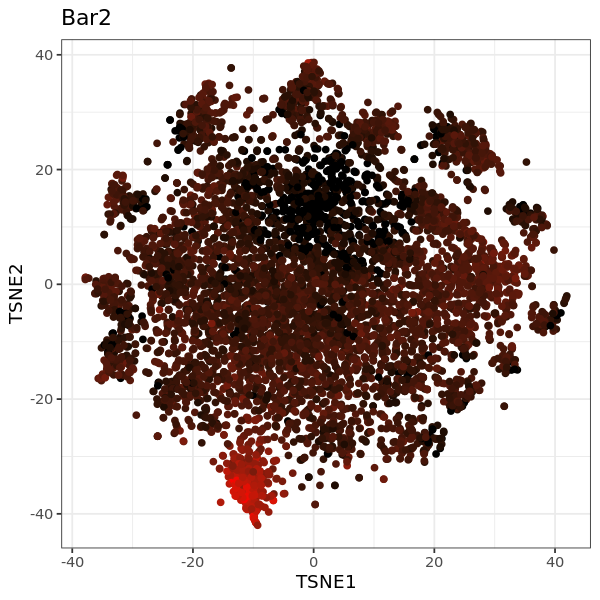

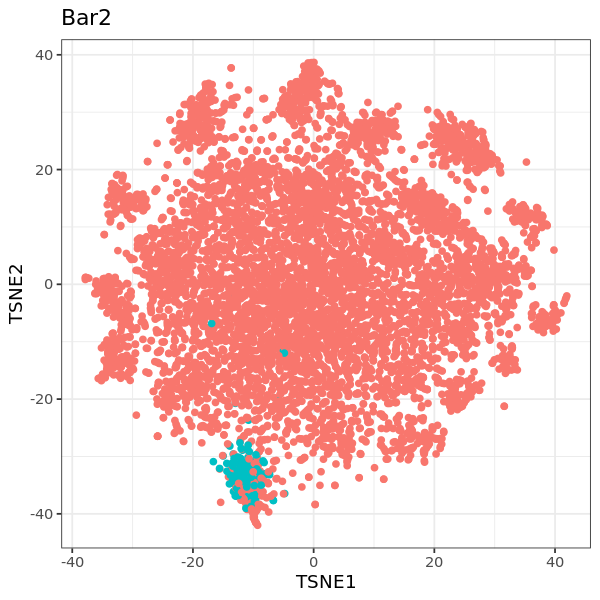

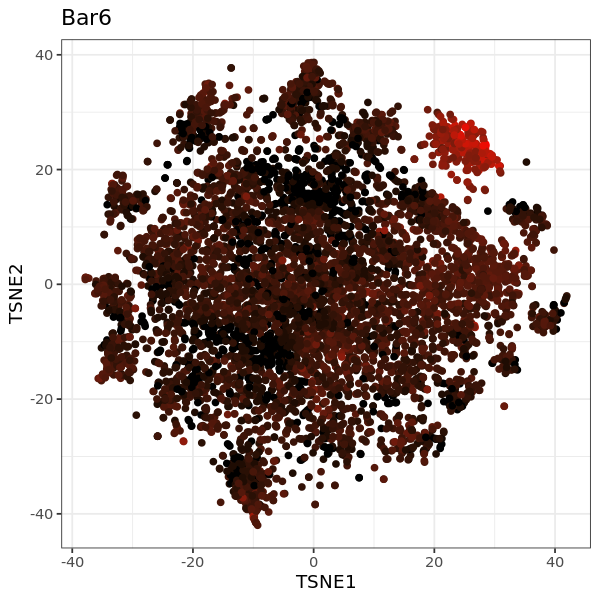

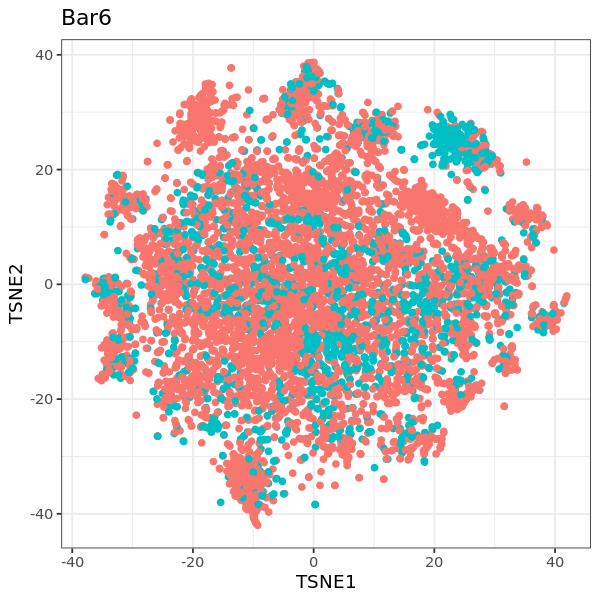

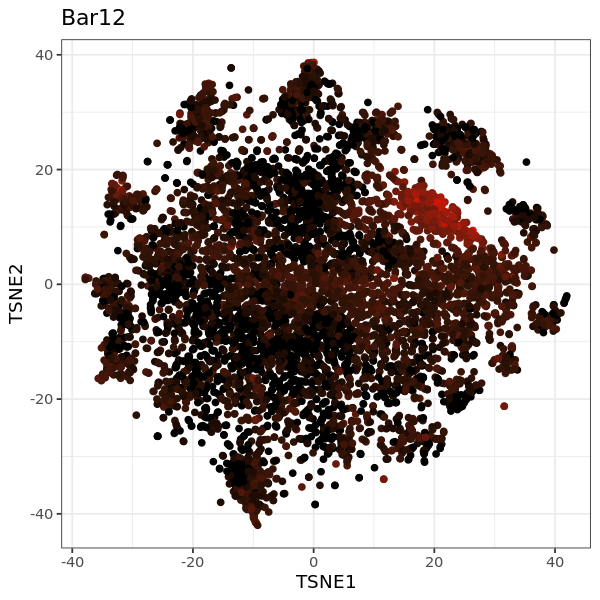

...

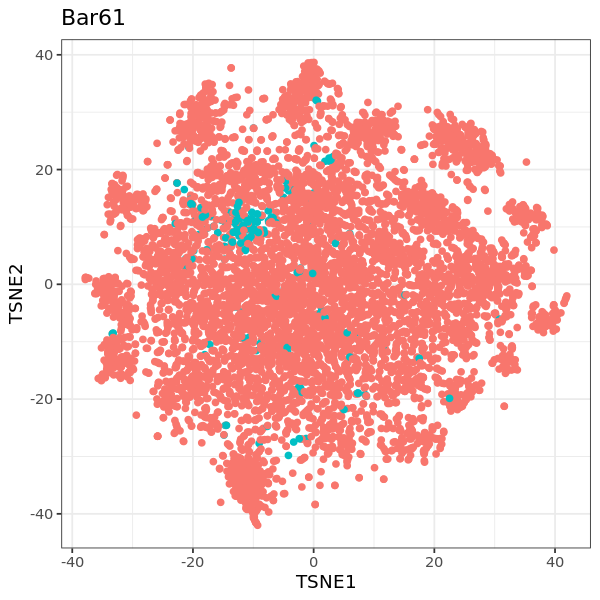

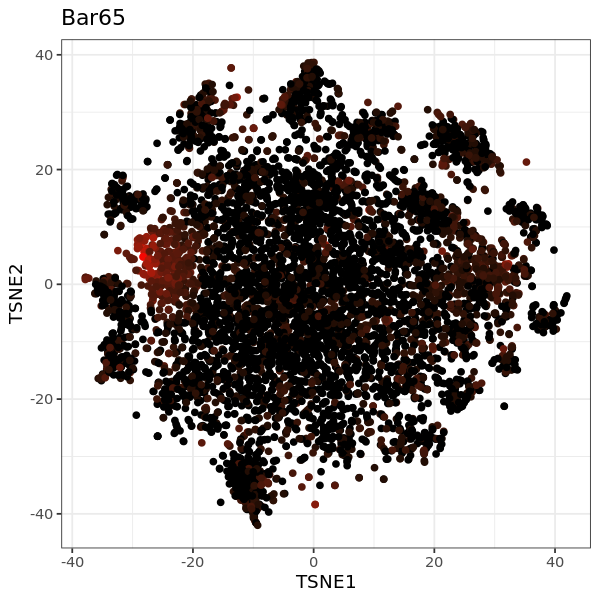

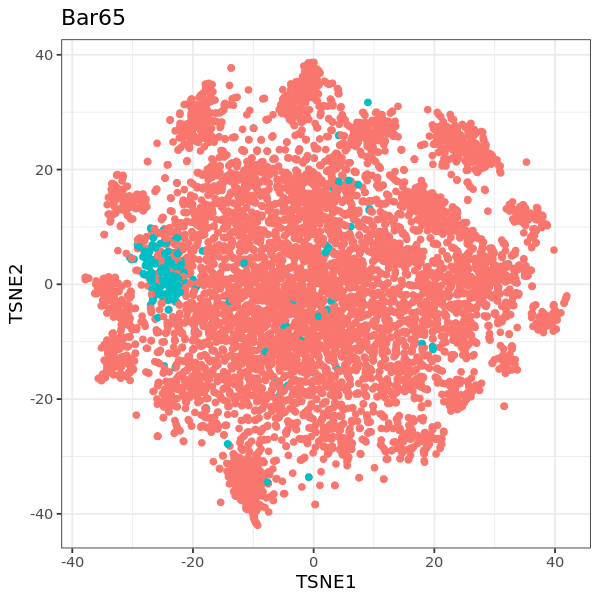

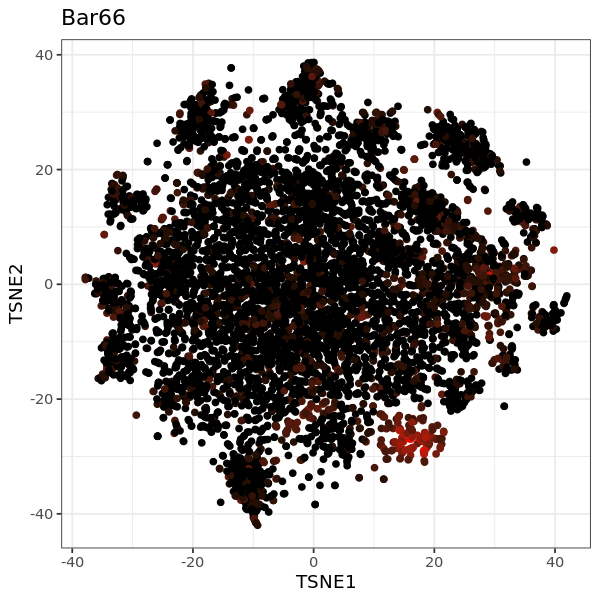

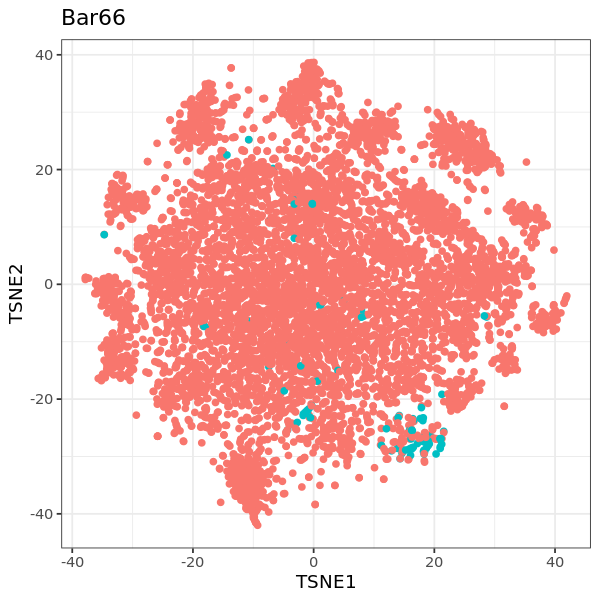

In [9]:
## Visualize barcode space
bar.tsne <- barTSNE(bar.table[,io$bars_used[[opts$experiment]][[opts$sample]]])
bar.tsne$MULTI_class <- final.calls.rescued[rownames(bar.tsne)]
options(repr.plot.width=5, repr.plot.height=5)
for (i in 3:(ncol(bar.tsne)-1)) {
    p <- ggplot(bar.tsne, aes(x = TSNE1, y = TSNE2, color = bar.tsne[,i])) +
        geom_point() +
        scale_color_gradient(low = "black", high = "red") +
        ggtitle(colnames(bar.tsne)[i]) +
        theme_bw() +
        theme(legend.position = "none") 
    print(p)
    p <- ggplot(bar.tsne, aes(x = TSNE1, y = TSNE2, color = MULTI_class == colnames(bar.tsne)[i])) +
        geom_point() +
        ggtitle(colnames(bar.tsne)[i]) +
        theme_bw() +
        theme(legend.position = "none") 
    print(p)
}

Performing PCA
Read the 7029 x 21 data matrix successfully!
OpenMP is working. 1 threads.
Using no_dims = 2, perplexity = 30.000000, and theta = 0.500000
Computing input similarities...
Building tree...
Done in 6.13 seconds (sparsity = 0.020453)!
Learning embedding...
Iteration 50: error is 91.520352 (50 iterations in 2.76 seconds)
Iteration 100: error is 91.520337 (50 iterations in 4.90 seconds)
Iteration 150: error is 91.460176 (50 iterations in 4.00 seconds)
Iteration 200: error is 91.412597 (50 iterations in 2.58 seconds)
Iteration 250: error is 91.410678 (50 iterations in 2.37 seconds)
Iteration 300: error is 4.081107 (50 iterations in 3.02 seconds)
Iteration 350: error is 3.702942 (50 iterations in 2.13 seconds)
Iteration 400: error is 3.511658 (50 iterations in 2.17 seconds)
Iteration 450: error is 3.398824 (50 iterations in 2.10 seconds)
Iteration 500: error is 3.321142 (50 iterations in 2.08 seconds)
Iteration 550: error is 3.265356 (50 iterations in 2.09 seconds)
Iteration 60

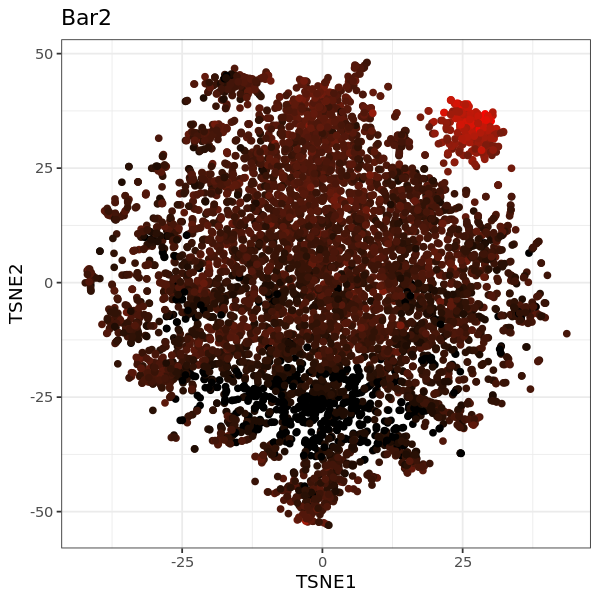

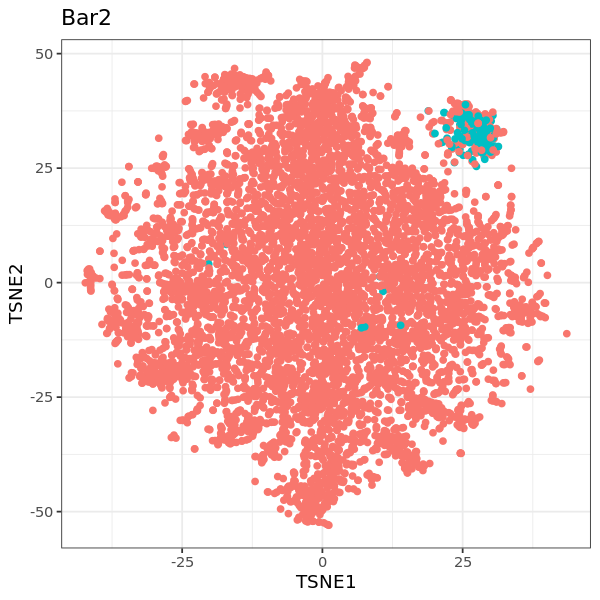

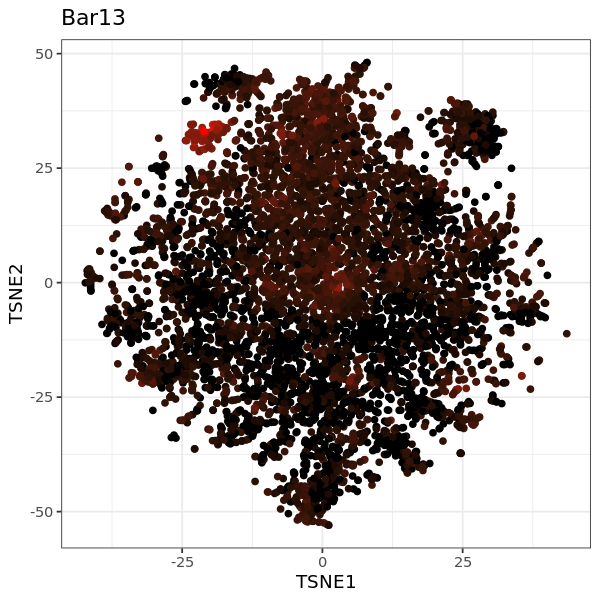

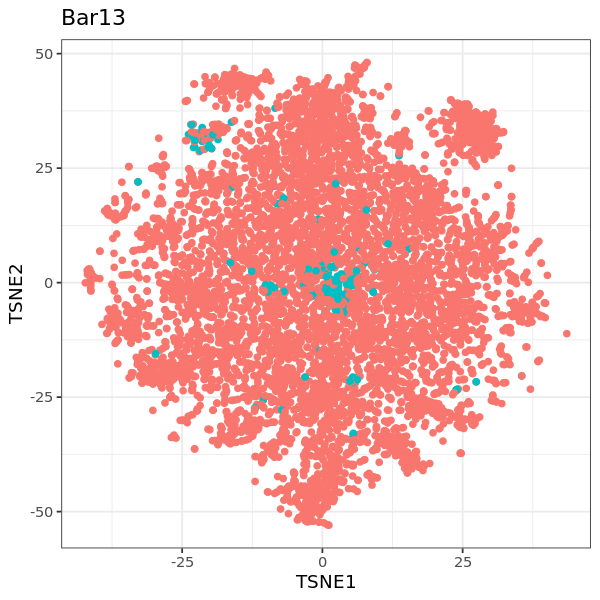

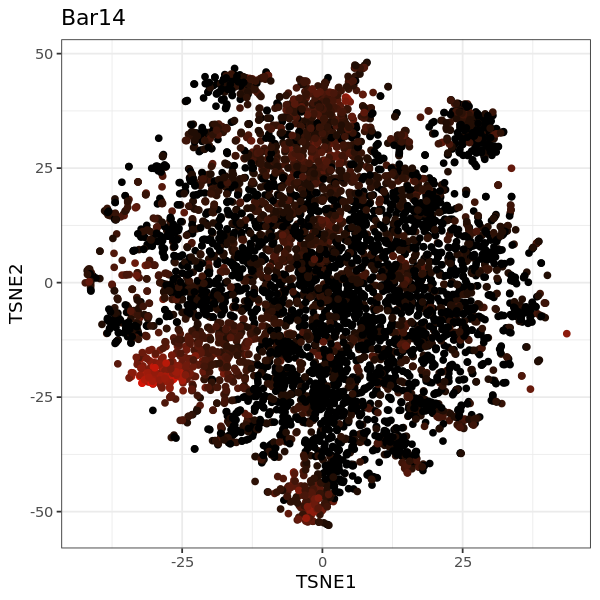

...

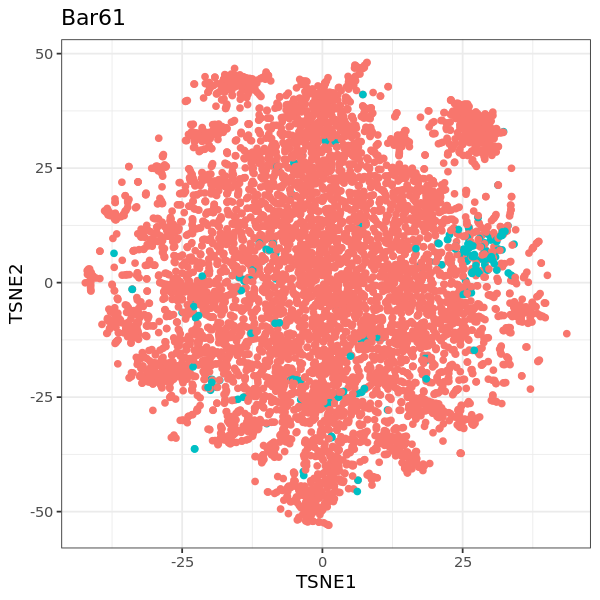

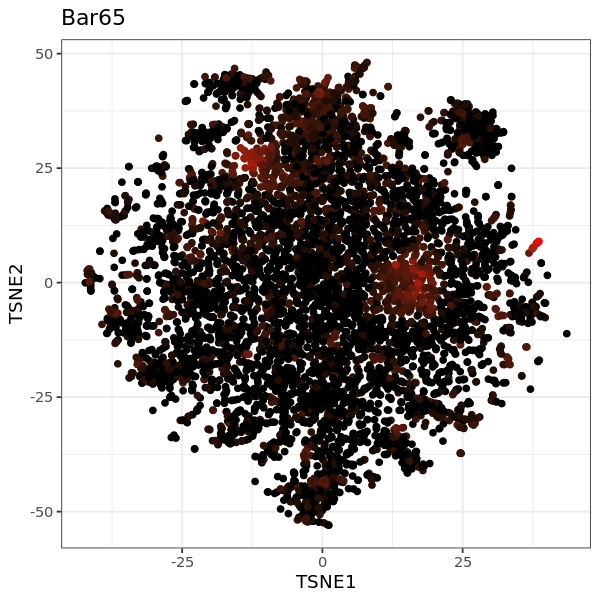

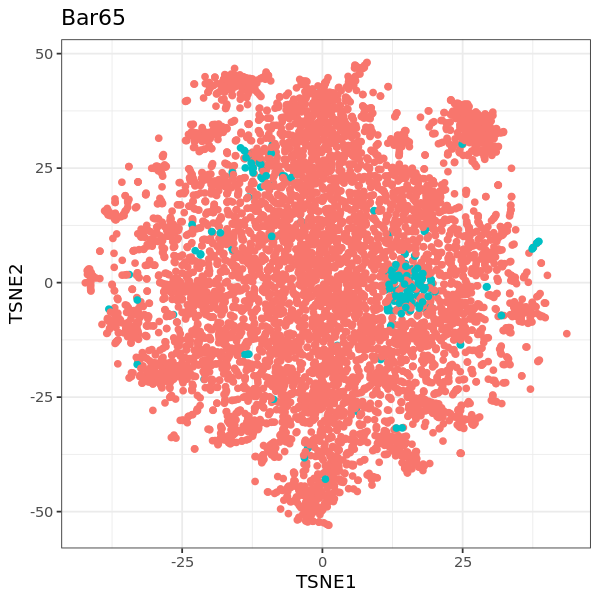

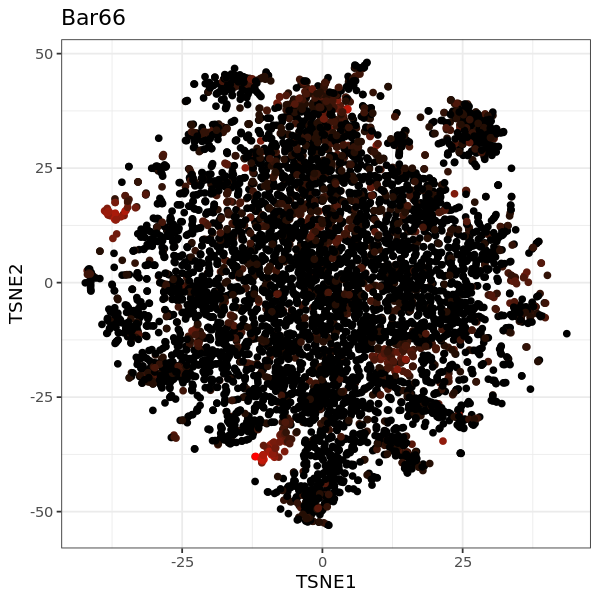

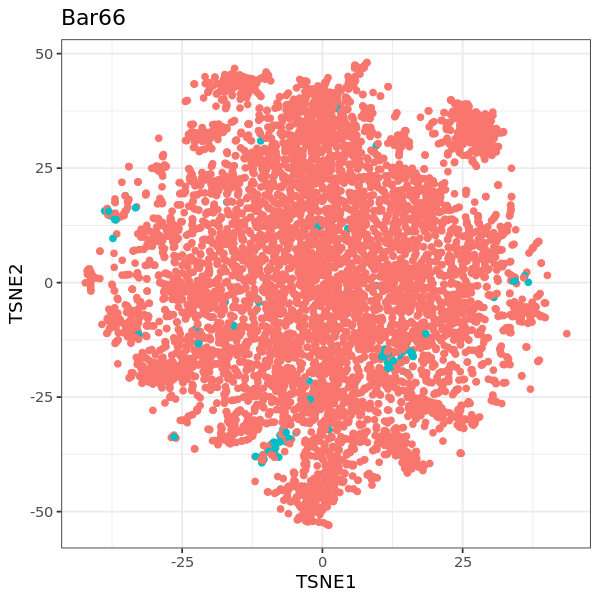

In [10]:
## Visualize barcode space
cols <- io$bars_used[[opts$experiment]][[opts$sample]]
cols <- cols[!(cols %in% c(6, 12, 24))]
bar.tsne.new <- barTSNE(bar.table[,cols])
bar.tsne.new$MULTI_class <- final.calls.rescued[rownames(bar.tsne.new)]
options(repr.plot.width=5, repr.plot.height=5)
for (i in 3:(ncol(bar.tsne.new)-1)) {
    p <- ggplot(bar.tsne.new, aes(x = TSNE1, y = TSNE2, color = bar.tsne.new[,i])) +
        geom_point() +
        scale_color_gradient(low = "black", high = "red") +
        ggtitle(colnames(bar.tsne.new)[i]) +
        theme_bw() +
        theme(legend.position = "none") 
    print(p)
    p <- ggplot(bar.tsne.new, aes(x = TSNE1, y = TSNE2, color = MULTI_class == colnames(bar.tsne.new)[i])) +
        geom_point() +
        ggtitle(colnames(bar.tsne.new)[i]) +
        theme_bw() +
        theme(legend.position = "none") 
    print(p)
}

In [11]:
bar.table.full <- bar.table[,1:96]
good.bars <- paste("Bar",io$bars_used[[opts$experiment]][[opts$sample]],sep="")  # Barcodes 1:24 were detected
#good.bars <- good.bars[!(good.bars %in% c('Bar24', 'Bar6', 'Bar12'))]
bar.table <- bar.table.full[, good.bars]  # Remove missing bars and summary columns

bar.table_sweep.list <- list()
n <- 0
for (q in seq(0.01, 0.99, by=0.02)) {
  #print(q)
  n <- n + 1
  bar.table_sweep.list[[n]] <- classifyCells(bar.table, q=q)
  names(bar.table_sweep.list)[n] <- paste("q=",q,sep="")
}

Loading required package: KernSmooth

KernSmooth 2.23 loaded
Copyright M. P. Wand 1997-2009



[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[

[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[

Loading required package: reshape2


Attaching package: ‘reshape2’


The following objects are masked from ‘package:data.table’:

    dcast, melt




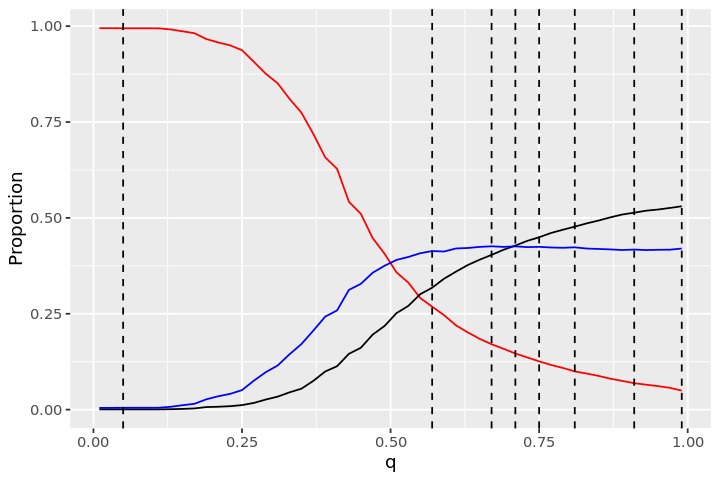

In [12]:
## Round 1 -----------------------------------------------------------------------------------------------------
## Perform Quantile Sweep

i <- 1
bar.table_sweep.list <- list()
n <- 0
for (q in seq(0.01, 0.99, by=0.02)) {
  n <- n + 1
  bar.table_sweep.list[[n]] <- classifyCells(bar.table, q=q)
  names(bar.table_sweep.list)[n] <- paste("q=",q,sep="")
}

## Identify ideal inter-maxima quantile to set barcode-specific thresholds

threshold.results <- findThresh(call.list=bar.table_sweep.list)
options(repr.plot.width=6, repr.plot.height=4)
p <- ggplot(data=threshold.results$res, aes(x=q, y=Proportion, color=Subset)) + geom_line() + theme(legend.position = "none") +
  geom_vline(xintercept=threshold.results$extrema, lty=2) + scale_color_manual(values=c("red","black","blue"))
print(p)

[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar6..."
[

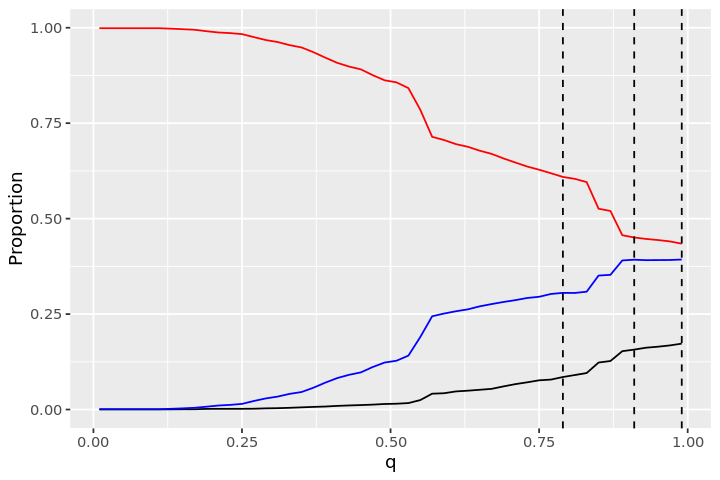

[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found f

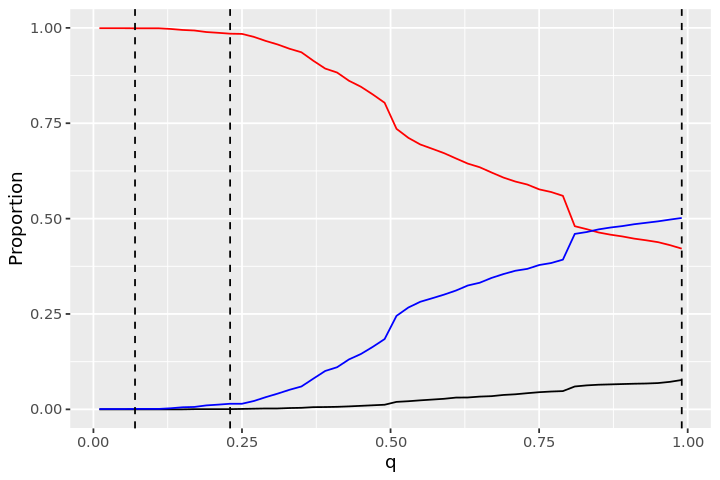

[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found f

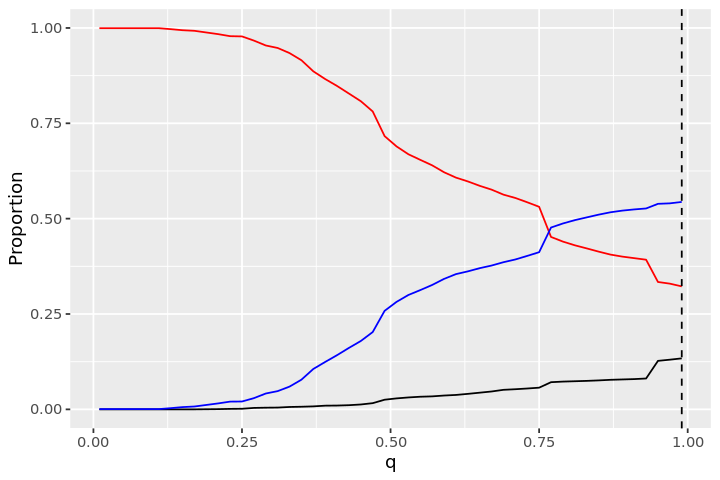

[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold fou

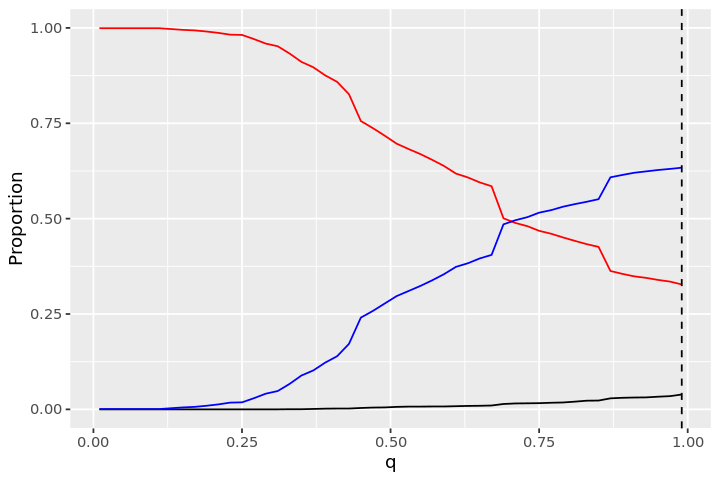

[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar6..."
[1] "No threshold found f

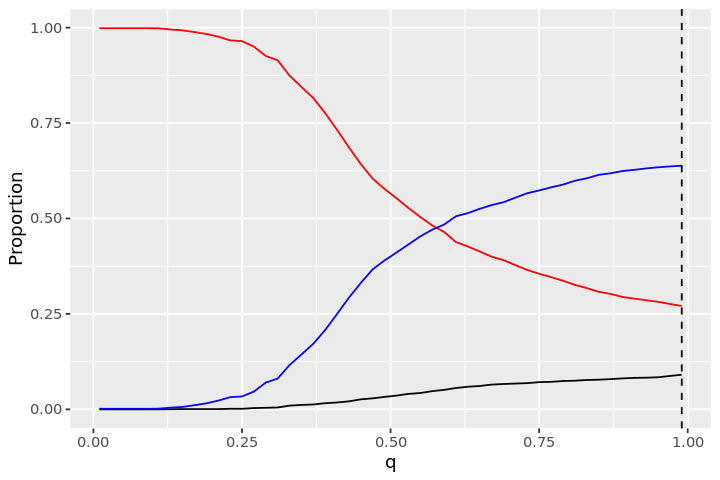

[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold fou

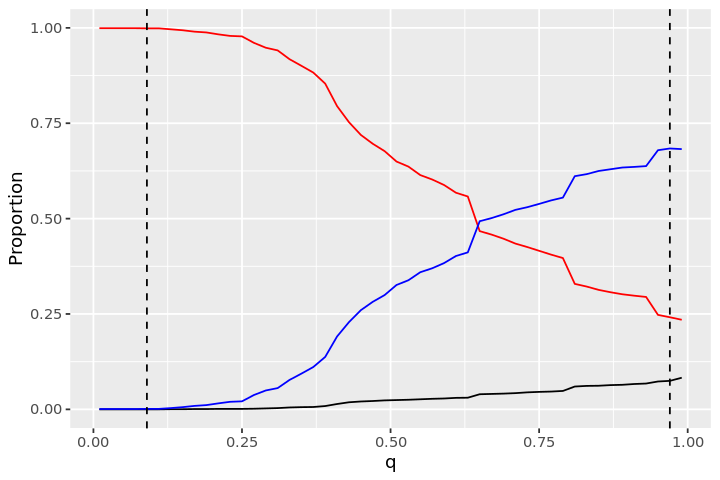

[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold fou

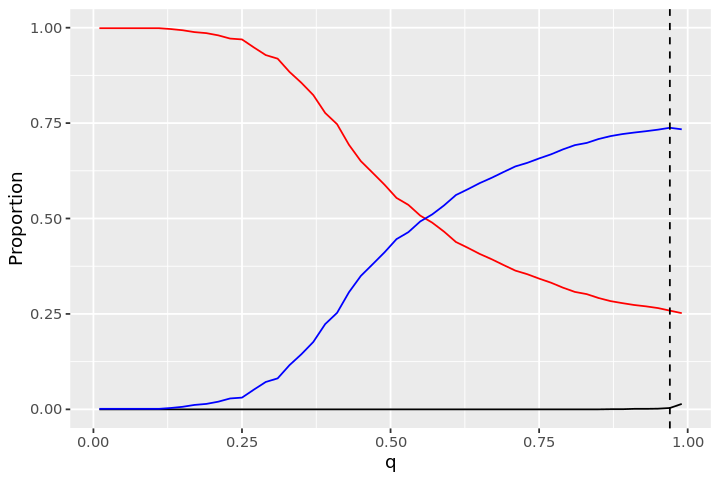

[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold fou

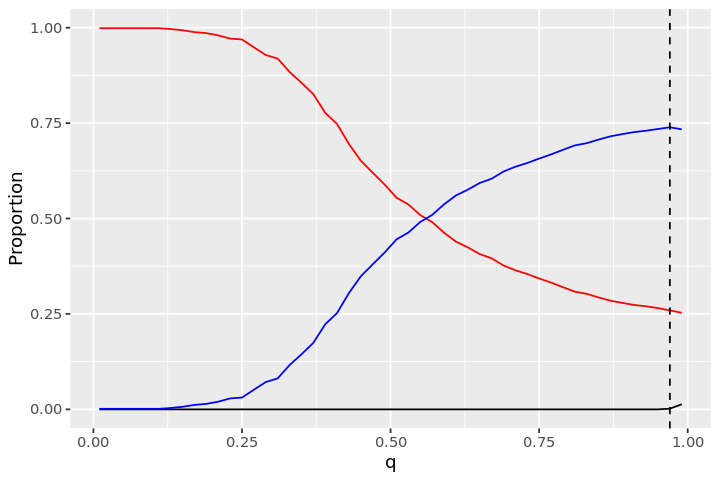

[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold fou

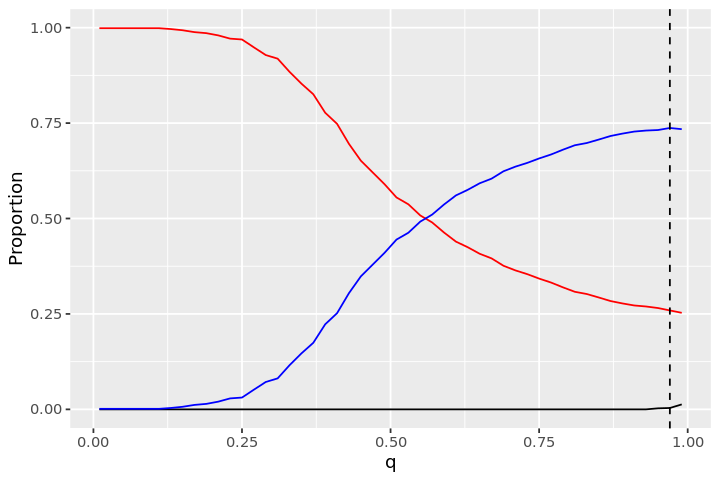

[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold fou

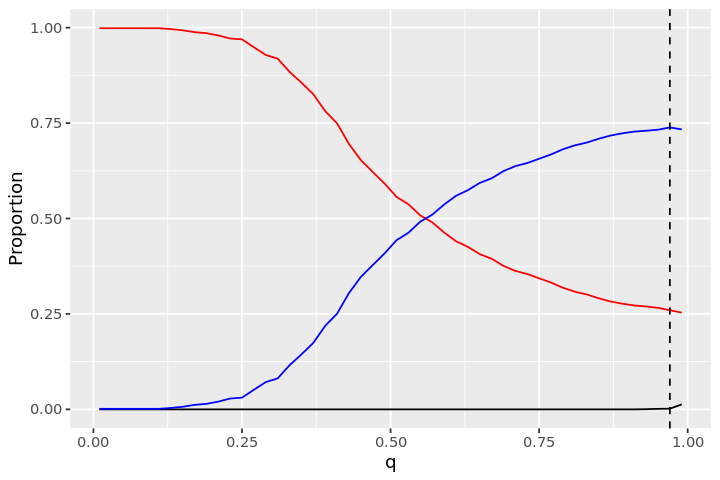

[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold fou

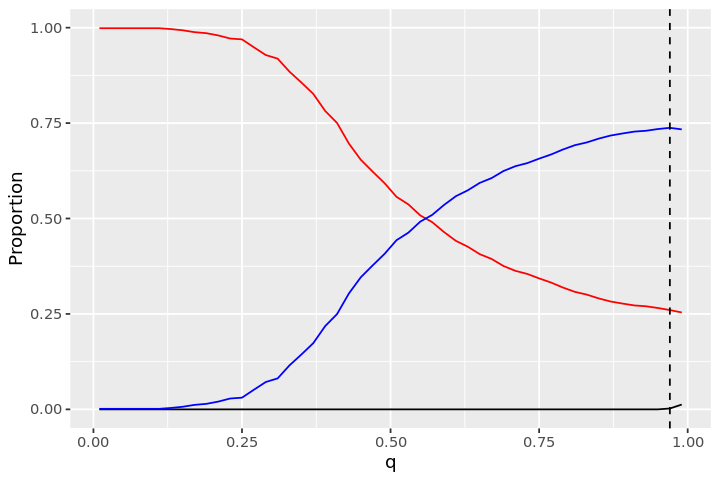

[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold fou

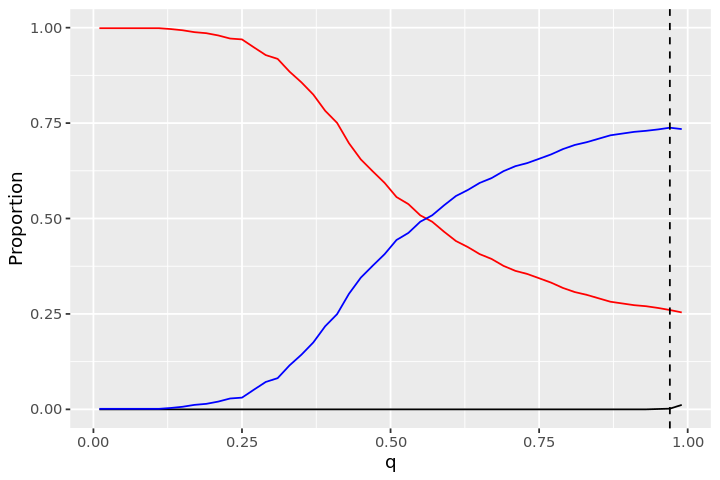

[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."
[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold fou

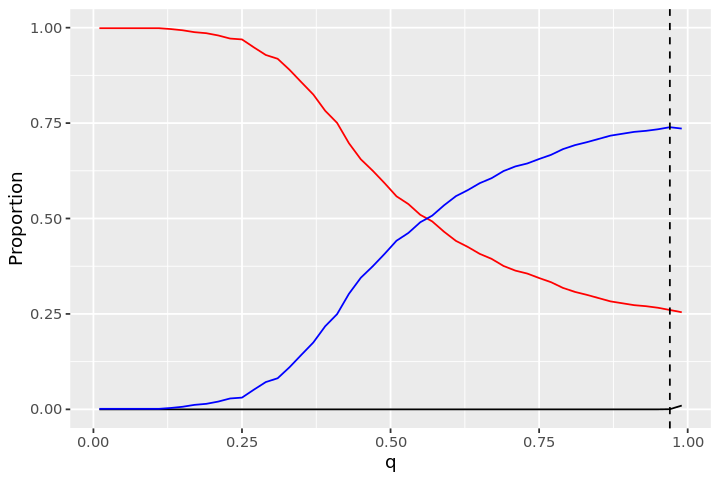

[1] "No threshold found for Bar6..."
[1] "No threshold found for Bar12..."
[1] "No threshold found for Bar24..."


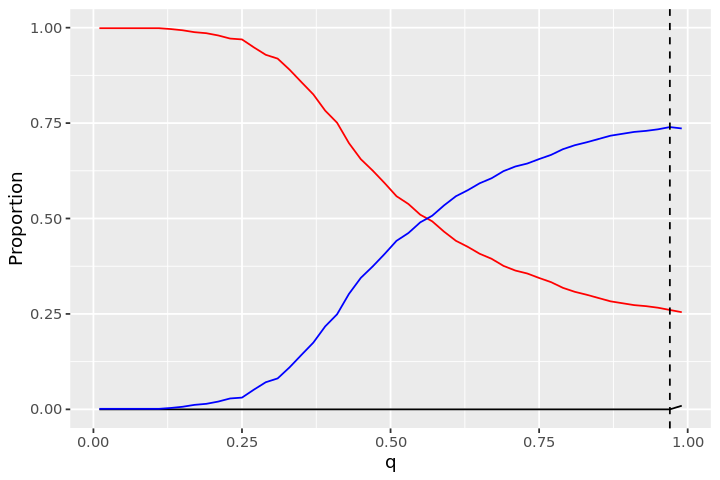

In [13]:
## Finalize round 1 classifications, remove negative cells
round.calls <- classifyCells(bar.table, q=findQ(threshold.results$res, threshold.results$extrema))
neg.cells <- names(round.calls)[which(round.calls == "Negative")]
bar.table <- bar.table[-which(rownames(bar.table) %in% neg.cells), ]

options(repr.plot.width=6, repr.plot.height=4)
while (length(names(round.calls)[which(round.calls == "Negative")]) > 0) {
    
    i <- i+1
    bar.table_sweep.list <- list()
    n <- 0
    for (q in seq(0.01, 0.99, by=0.02)) {
      #print(q)
      n <- n + 1
      bar.table_sweep.list[[n]] <- classifyCells(bar.table, q=q)
      names(bar.table_sweep.list)[n] <- paste("q=",q,sep="")
    }
    
    error1 <- FALSE
    tryCatch(threshold.results <- findThresh(call.list=bar.table_sweep.list),
             error = function(e) { error1 <<- TRUE}
            )
    if (error1==TRUE) {
        break
    }

    threshold.results <- findThresh(call.list=bar.table_sweep.list)
    p <- ggplot(data=threshold.results$res, aes(x=q, y=Proportion, color=Subset)) + geom_line() + theme(legend.position = "none") +
      geom_vline(xintercept=threshold.results$extrema, lty=2) + scale_color_manual(values=c("red","black","blue"))
    print(p)
    round.calls <- classifyCells(bar.table, q=findQ(threshold.results$res, threshold.results$extrema))
    neg.cells <- c(neg.cells, names(round.calls)[which(round.calls == "Negative")])
    bar.table <- bar.table[-which(rownames(bar.table) %in% neg.cells), ]
    
}

In [14]:
final.calls <- c(round.calls, rep("Negative",length(neg.cells)))
names(final.calls) <- c(names(round.calls),neg.cells)

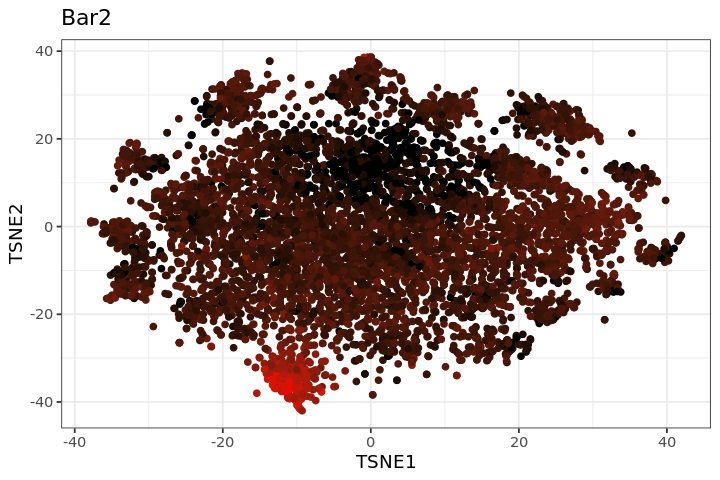

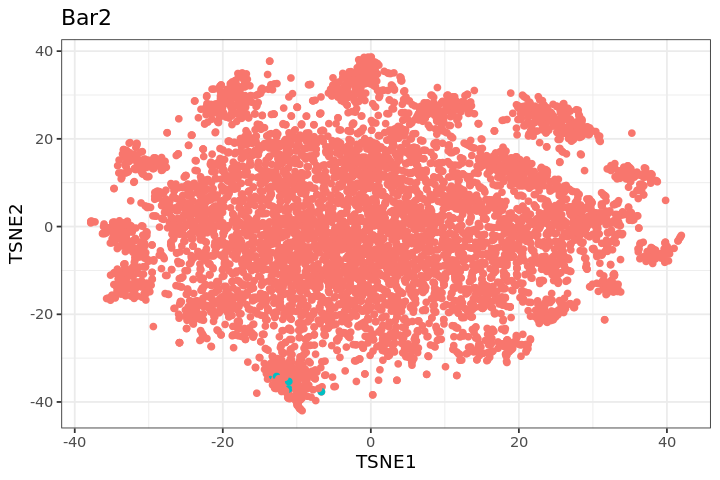

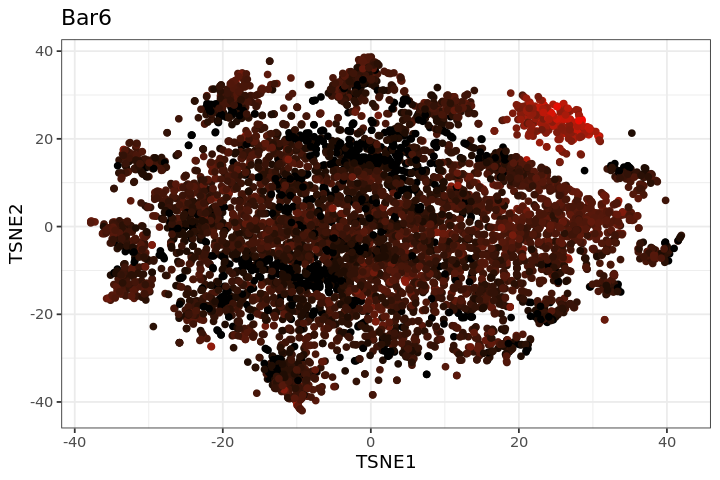

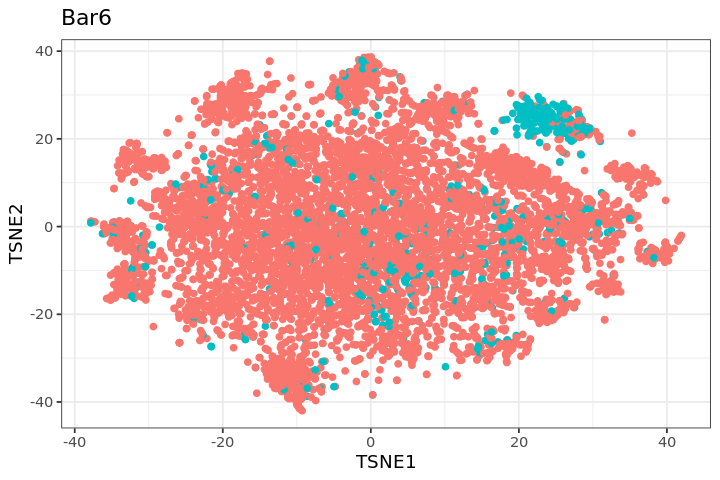

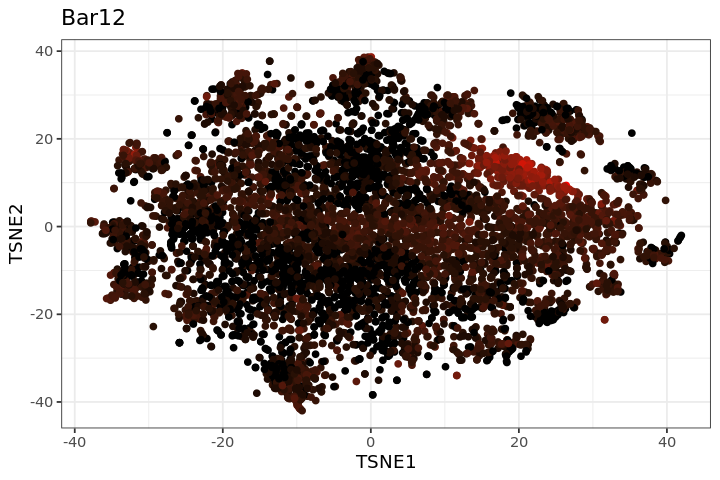

...

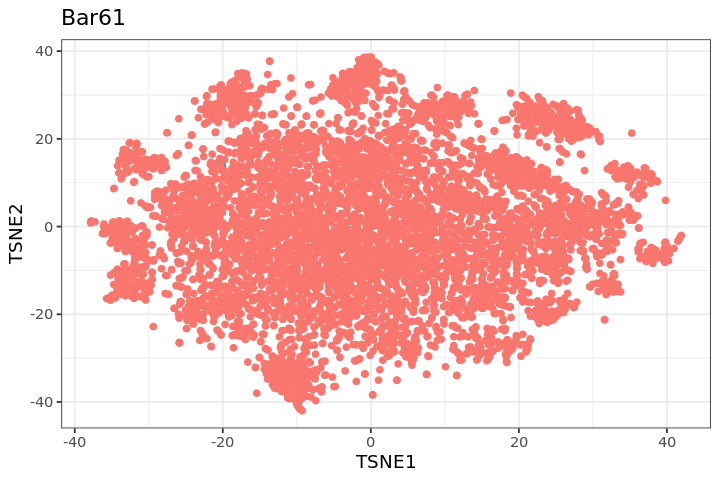

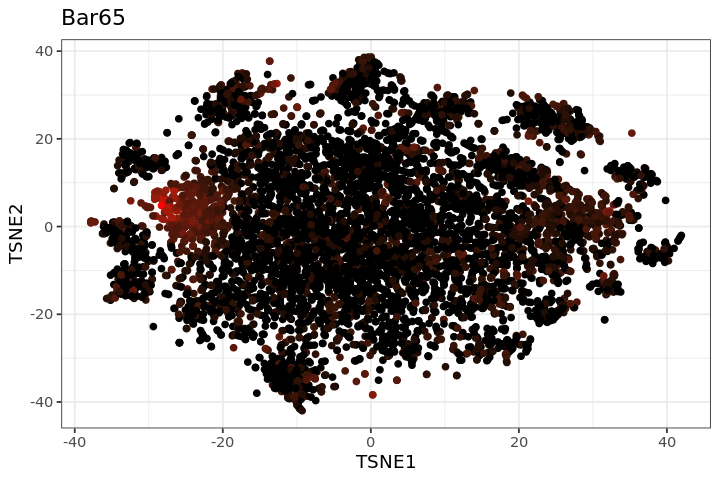

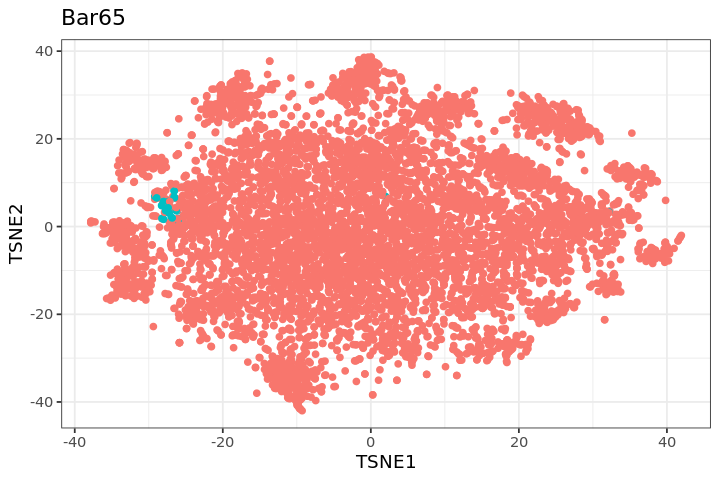

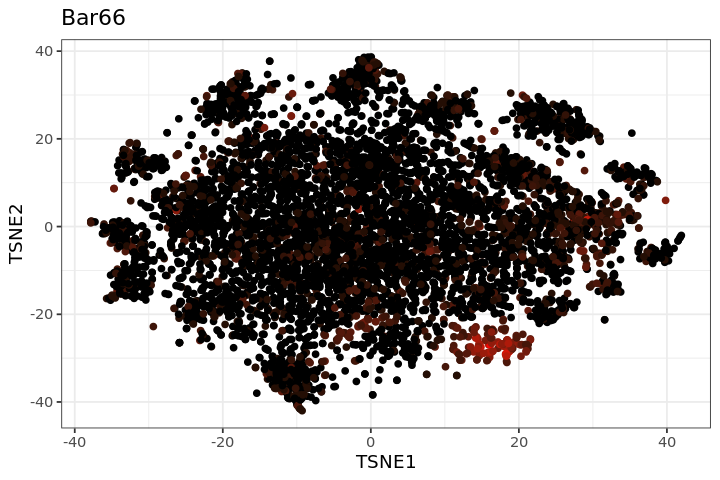

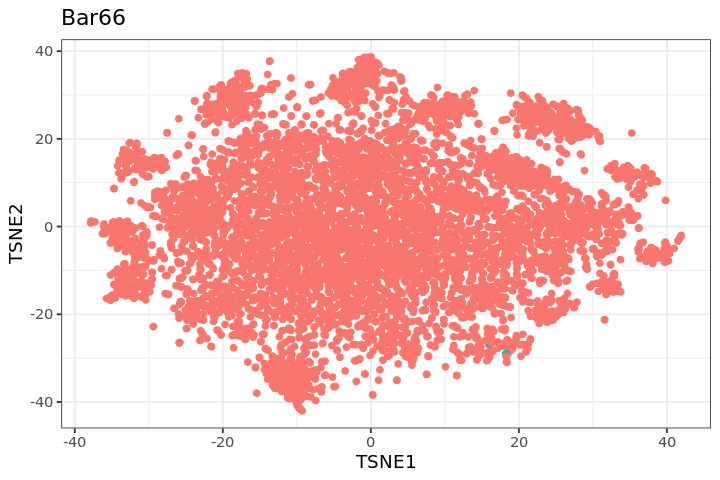

In [15]:
bar.tsne$MULTI_class_new <- final.calls[rownames(bar.tsne)]
for (i in 3:(ncol(bar.tsne)-2)) {
    p <- ggplot(bar.tsne, aes(x = TSNE1, y = TSNE2, color = bar.tsne[,i])) +
        geom_point() +
        scale_color_gradient(low = "black", high = "red") +
        ggtitle(colnames(bar.tsne)[i]) +
        theme_bw() +
        theme(legend.position = "none") 
    print(p)
    p <- ggplot(bar.tsne, aes(x = TSNE1, y = TSNE2, color = MULTI_class_new == colnames(bar.tsne)[i])) +
        geom_point() +
        ggtitle(colnames(bar.tsne)[i]) +
        theme_bw() +
        theme(legend.position = "none") 
    print(p)
}

Warning message:
“Transformation introduced infinite values in discrete y-axis”
Warning message:
“Transformation introduced infinite values in discrete y-axis”


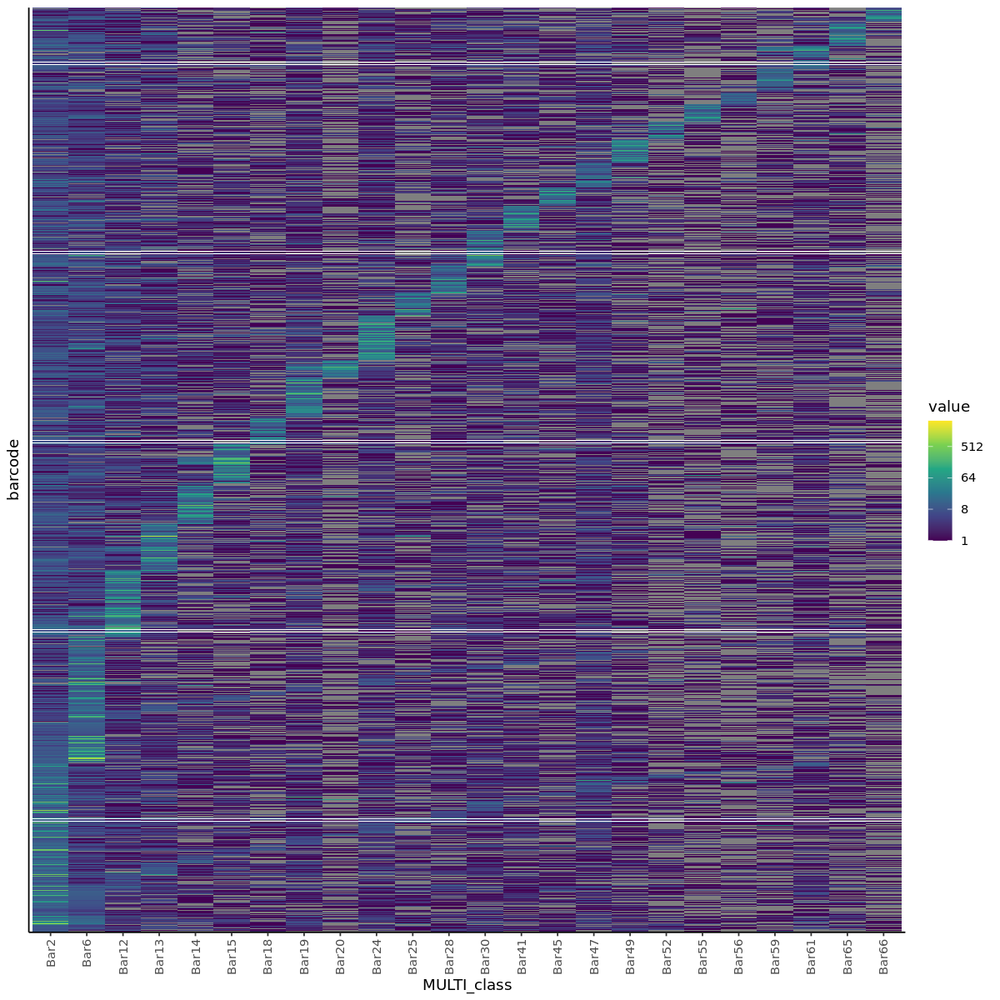

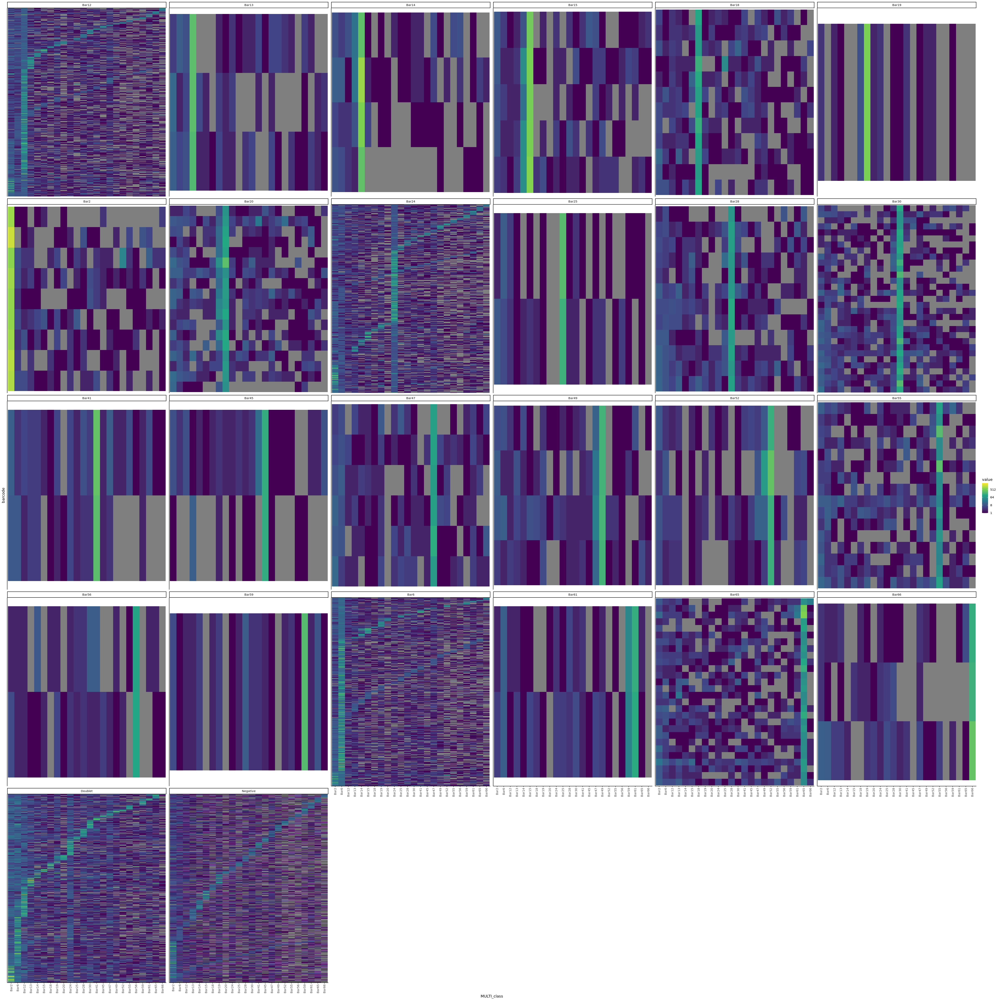

In [16]:
bar.table.hm <- bar.table.full[names(final.calls),good.bars]
bar.table.hm <- data.table(bar.table.hm)
rownames(bar.table.hm) <- names(final.calls)

argmax <- max.col(bar.table.hm)
bar.table.hm.sorted <- bar.table.hm[sort(argmax, index.return=TRUE)$ix,]
rownames(bar.table.hm.sorted) <- rownames(bar.table.hm)[sort(argmax, index.return=TRUE)$ix]
argmax2 <- max.col(replace(as.matrix(bar.table.hm.sorted), cbind(1:dim(bar.table.hm.sorted)[1], max.col(as.matrix(bar.table.hm.sorted))), -Inf))

sorted_argmax <- max.col(bar.table.hm.sorted)
rns <- rownames(bar.table.hm.sorted)
for (i in unique(argmax)) {
    bar.table.hm.sorted[sorted_argmax==i,] = bar.table.hm.sorted[sorted_argmax==i,][sort(argmax2[sorted_argmax==i], index.return=TRUE)$ix,]
    
    rns[sorted_argmax==i] <- rns[sorted_argmax==i][sort(argmax2[sorted_argmax==i], index.return=TRUE)$ix]
}
bar.table.hm.sorted <- as.matrix(bar.table.hm.sorted)
rownames(bar.table.hm.sorted) <- rns

to.plot <- melt(bar.table.hm.sorted, varnames = c("barcode", "MULTI_class"))
to.plot$final_call <- unname(final.calls[as.character(to.plot$barcode)])

options(repr.plot.width=10, repr.plot.height=10)
p <- ggplot(to.plot, aes(MULTI_class, barcode, fill= value)) + 
  geom_tile() +
  #scale_fill_gradient( trans = 'log2' ) +
  #scale_fill_gradient(low="white", high="#2171b5", trans = 'log2')
  scale_fill_continuous(type = "viridis", trans = 'log2') +
  theme_classic() +
  theme(axis.text.y=element_blank(),
        axis.ticks.y=element_blank(),
        axis.text.x = element_text(angle = 90, vjust = 0.5, hjust=1))
print(p)

options(repr.plot.width=40, repr.plot.height=40)
p <- ggplot(to.plot, aes(MULTI_class, barcode, fill= value)) + 
  geom_tile() +
  #scale_fill_gradient( trans = 'log2' ) +
  #scale_fill_gradient(low="white", high="#2171b5", trans = 'log2')
  scale_fill_continuous(type = "viridis", trans = 'log2') +
  theme_classic() +
  theme(axis.text.y=element_blank(),
        axis.ticks.y=element_blank(),
        axis.text.x = element_text(angle = 90, vjust = 0.5, hjust=1)) +
  facet_wrap(~final_call, scales = "free_y")
print(p)

In [17]:
table(final.calls)

final.calls
   Bar12    Bar13    Bar14    Bar15    Bar18    Bar19     Bar2    Bar20 
     459        3        4        5       12        1        9       18 
   Bar24    Bar25    Bar28    Bar30    Bar41    Bar45    Bar47    Bar49 
     449        2       12       31        2        2        6        4 
   Bar52    Bar55    Bar56    Bar59     Bar6    Bar61    Bar65    Bar66 
       4       16        2        1      558        2       28        3 
 Doublet Negative 
     575     4821 

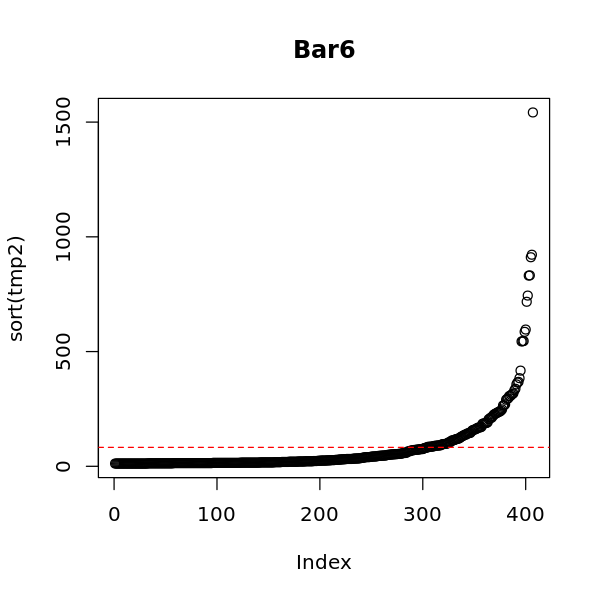

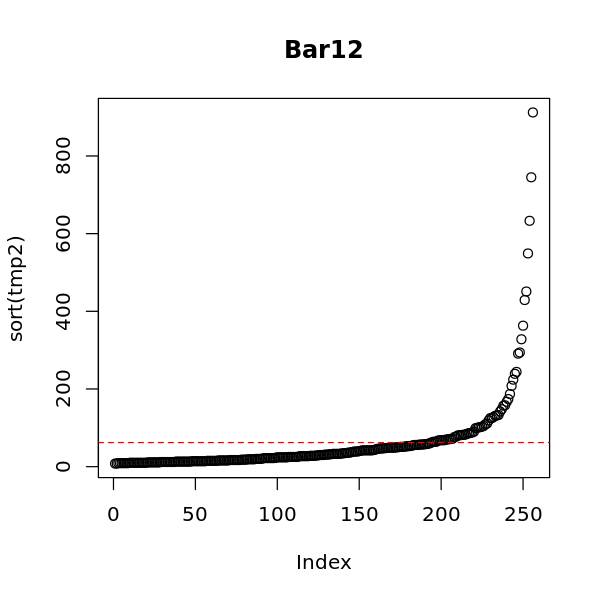

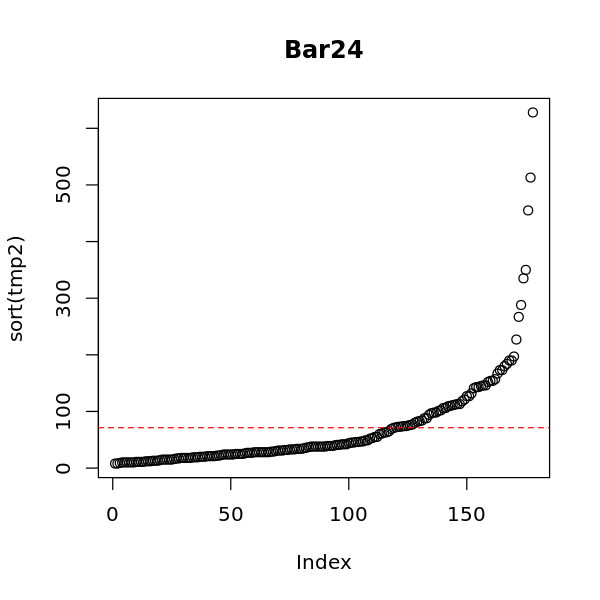

In [18]:
final.calls2 <- final.calls
for (bar in c('Bar6', 'Bar12', 'Bar24')) {
    tmp <- bar.table.full[names(final.calls)[final.calls == bar],good.bars]
    final.calls2[rownames(tmp)[good.bars[max.col(tmp, ties.method="first")] != bar]] <- 'Negative'
    tmp2 <- tmp[good.bars[max.col(tmp, ties.method="first")] == bar,bar]
    names(tmp2) <- rownames(tmp[good.bars[max.col(tmp, ties.method="first")] == bar,])
    options(repr.plot.width=5, repr.plot.height=5)
    plot(sort(tmp2), main=bar)
    abline(h = mean(tmp2), col="red", lwd=1, lty=2)
    summary(sort(tmp2))
    #final.calls2[names(tmp2[tmp2<mean(tmp2)])] <- 'Negative'
}

In [19]:
table(final.calls2)

final.calls2
   Bar12    Bar13    Bar14    Bar15    Bar18    Bar19     Bar2    Bar20 
     256        3        4        5       12        1        9       18 
   Bar24    Bar25    Bar28    Bar30    Bar41    Bar45    Bar47    Bar49 
     178        2       12       31        2        2        6        4 
   Bar52    Bar55    Bar56    Bar59     Bar6    Bar61    Bar65    Bar66 
       4       16        2        1      407        2       28        3 
 Doublet Negative 
     575     5446 

In [20]:
tmp <- bar.table.full[names(final.calls)[final.calls == 'Doublet'],good.bars]
final.calls2[rownames(tmp)[good.bars[max.col(tmp, ties.method="first")] %in% c("Bar6", "Bar12", "Bar24")]] <- 'Negative'
tmp2 <- tmp[good.bars[max.col(tmp, ties.method="first")] %in% c("Bar6", "Bar12", "Bar24"),good.bars]
argmax2 <- max.col(replace(as.matrix(tmp2), cbind(1:dim(tmp2)[1], max.col(as.matrix(tmp2))), -Inf))
final.calls2[rownames(tmp2)[good.bars[argmax2] %in% c("Bar6", "Bar12", "Bar24")]] <- 'Negative'

In [21]:
table(final.calls2)

final.calls2
   Bar12    Bar13    Bar14    Bar15    Bar18    Bar19     Bar2    Bar20 
     256        3        4        5       12        1        9       18 
   Bar24    Bar25    Bar28    Bar30    Bar41    Bar45    Bar47    Bar49 
     178        2       12       31        2        2        6        4 
   Bar52    Bar55    Bar56    Bar59     Bar6    Bar61    Bar65    Bar66 
       4       16        2        1      407        2       28        3 
 Doublet Negative 
     290     5731 

[1] "Normalizing barode data..."
[1] "Pre-allocating data structures..."
[1] "Determining classifications for negative cells across all BCs, all q..."
[1] "Computing classification stability..."
[1] "Extracting rescued classifications..."
[1] "Normalizing barode data..."
[1] "Pre-allocating data structures..."
[1] "Determining classifications for negative cells across all BCs, all q..."
[1] "Computing classification stability..."
[1] "Extracting rescued classifications..."
[1] 1
[1] 1


Warning message:
“Removed 9 rows containing missing values (geom_point).”
Warning message:
“Removed 1 rows containing missing values (geom_hline).”
Warning message:
“Removed 1 rows containing missing values (geom_hline).”


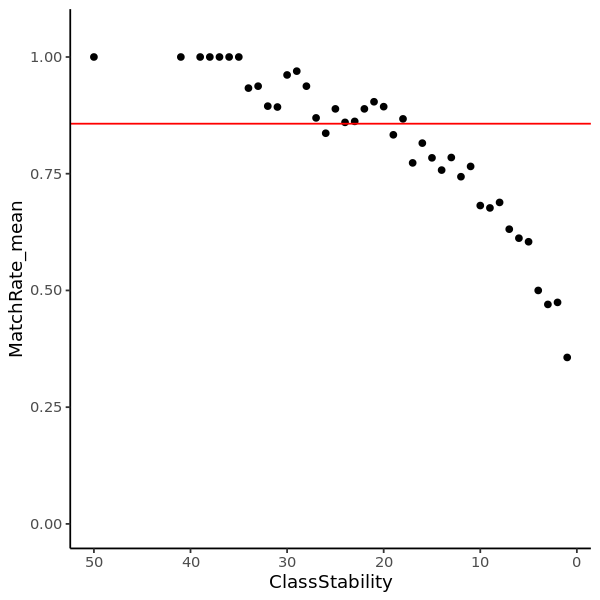

In [22]:
options(repr.plot.width=5, repr.plot.height=5)
## Perform semi-supervised negative cell reclassification
if (!error1) {
    
    error2 <- FALSE
    tryCatch(reclass.cells <- findReclassCells(bar.table.full[,good.bars[!(good.bars %in% c('Bar6', 'Bar12', 'Bar24'))]], names(final.calls)[which(final.calls=="Negative")]),
             error = function(e) { error2 <<- TRUE}
            )
    
    if (!error2) {
    
        reclass.cells <- findReclassCells(bar.table.full[,good.bars[!(good.bars %in% c('Bar6', 'Bar12', 'Bar24'))]], names(final.calls2)[which(final.calls2=="Negative")])
        error3 <- FALSE
        tryCatch(reclass.res <- rescueCells(bar.table.full[,good.bars[!(good.bars %in% c('Bar6', 'Bar12', 'Bar24'))]], final.calls2, reclass.cells),
                 error = function(e) { error3 <<- TRUE}
                )
        if (!error3) {

            reclass.res <- rescueCells(bar.table.full[,good.bars[!(good.bars %in% c('Bar6', 'Bar12', 'Bar24'))]], final.calls2, reclass.cells)

            ## Visualize Results
            p <- ggplot(reclass.res[-1, ], aes(x=ClassStability, y=MatchRate_mean)) + 
                geom_point() + xlim(c(nrow(reclass.res)-1,1)) + 
                ylim(c(0,1.05)) +
                geom_errorbar(aes(ymin=MatchRate_mean-MatchRate_sd, ymax=MatchRate_mean+MatchRate_sd), width=.1) +
                geom_hline(yintercept = reclass.res$MatchRate_mean[1], color="red") +
                geom_hline(yintercept = reclass.res$MatchRate_mean[1]+3*reclass.res$MatchRate_sd[1], color="red",lty=2) +
                geom_hline(yintercept = reclass.res$MatchRate_mean[1]-3*reclass.res$MatchRate_sd[1], color="red",lty=2) +
                theme_classic()
            print(p)

            ## Finalize negative cell rescue results
            final.calls.rescued <- final.calls2
            rescue.ind <- which(reclass.cells$ClassStability >= io$reclass_stability[[opts$experiment]][[opts$sample]]) ## Note: Value will be dataset-specific
            final.calls.rescued[rownames(reclass.cells)[rescue.ind]] <- reclass.cells$Reclassification[rescue.ind]

        }
    }
}

In [23]:
table(final.calls)

final.calls
   Bar12    Bar13    Bar14    Bar15    Bar18    Bar19     Bar2    Bar20 
     459        3        4        5       12        1        9       18 
   Bar24    Bar25    Bar28    Bar30    Bar41    Bar45    Bar47    Bar49 
     449        2       12       31        2        2        6        4 
   Bar52    Bar55    Bar56    Bar59     Bar6    Bar61    Bar65    Bar66 
       4       16        2        1      558        2       28        3 
 Doublet Negative 
     575     4821 

In [24]:
table(final.calls2)

final.calls2
   Bar12    Bar13    Bar14    Bar15    Bar18    Bar19     Bar2    Bar20 
     256        3        4        5       12        1        9       18 
   Bar24    Bar25    Bar28    Bar30    Bar41    Bar45    Bar47    Bar49 
     178        2       12       31        2        2        6        4 
   Bar52    Bar55    Bar56    Bar59     Bar6    Bar61    Bar65    Bar66 
       4       16        2        1      407        2       28        3 
 Doublet Negative 
     290     5731 

In [25]:
table(final.calls.rescued)

final.calls.rescued
   Bar12    Bar13    Bar14    Bar15    Bar18    Bar19     Bar2    Bar20 
     256      317      232      215      296      302      232      150 
   Bar24    Bar25    Bar28    Bar30    Bar41    Bar45    Bar47    Bar49 
     178      314      432      314      181      170      357      193 
   Bar52    Bar55    Bar56    Bar59     Bar6    Bar61    Bar65    Bar66 
     174      323      235      219      407      392      332      190 
 Doublet Negative 
     290      328 

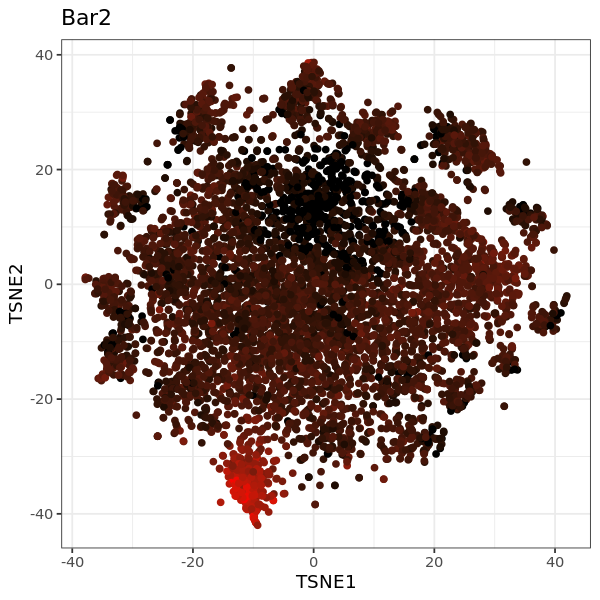

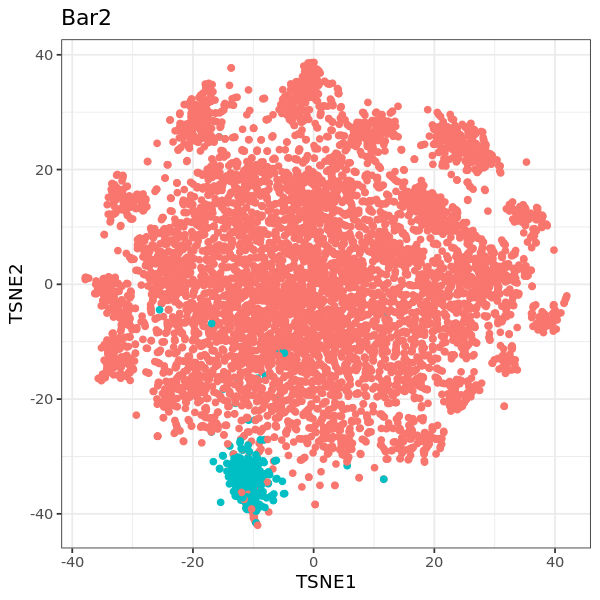

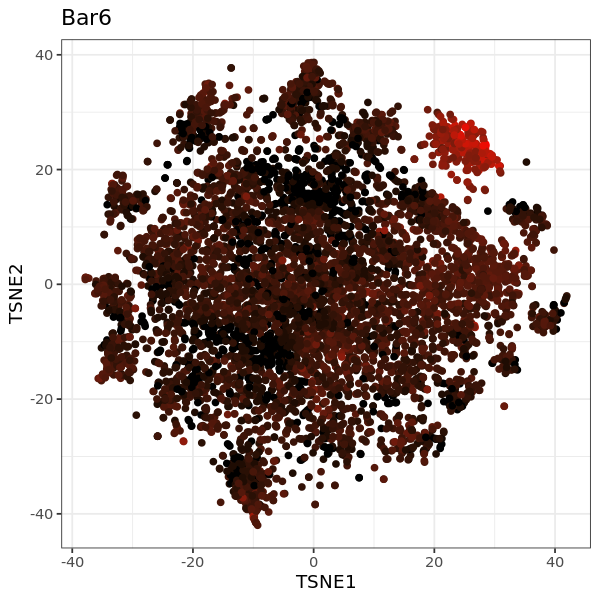

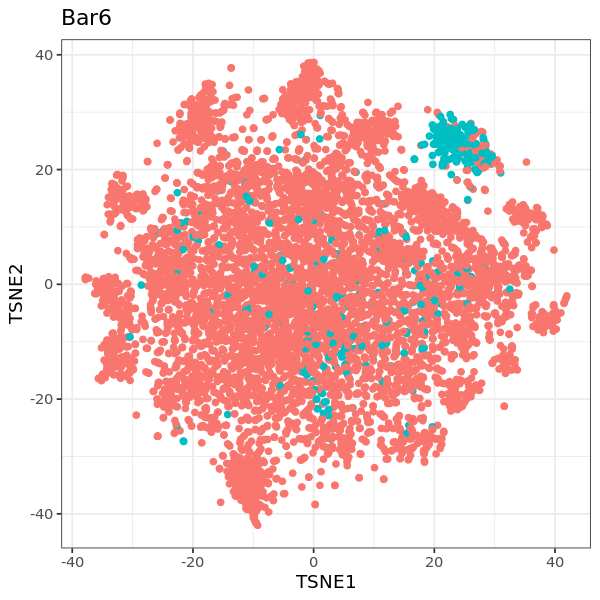

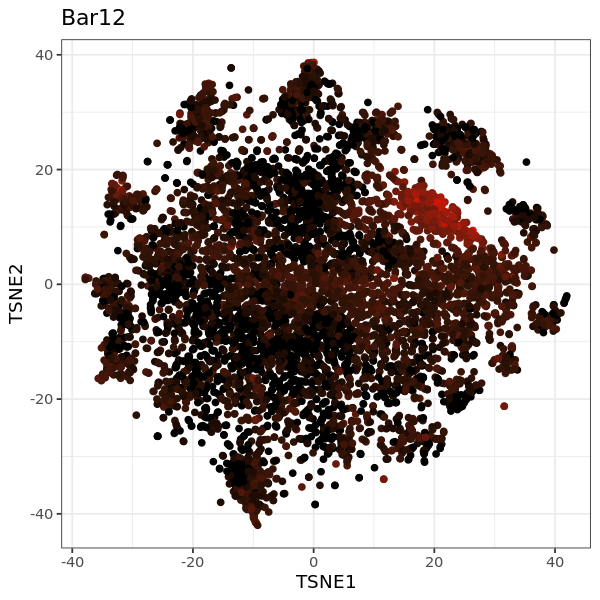

...

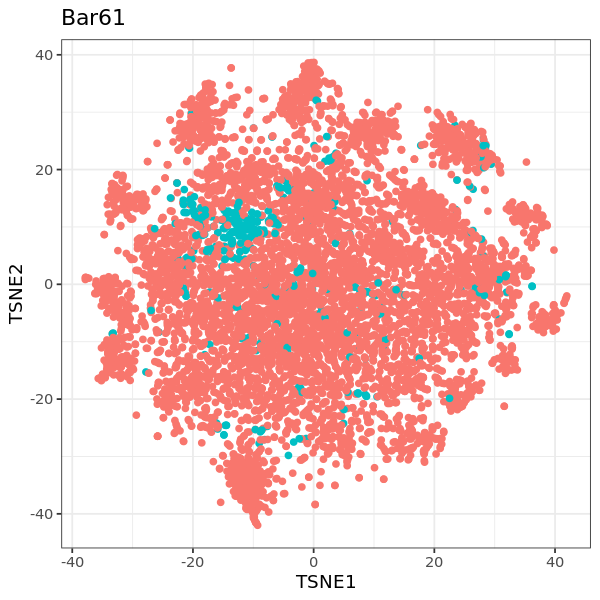

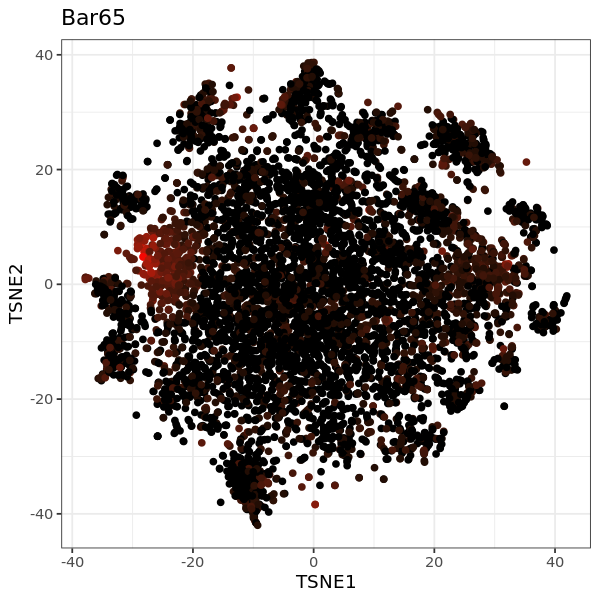

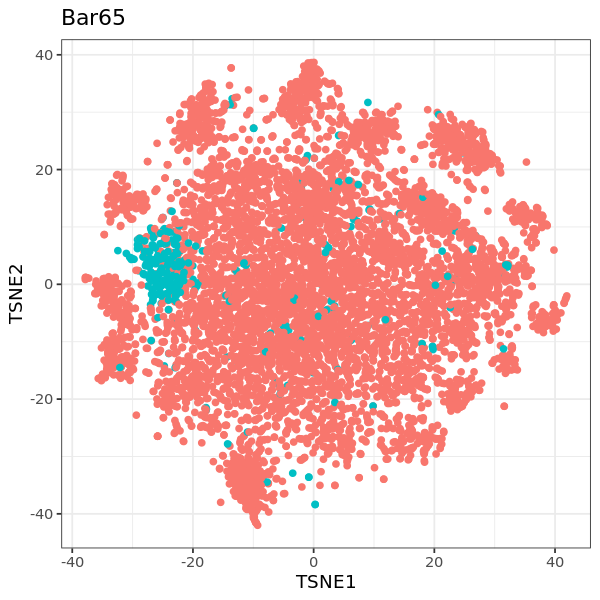

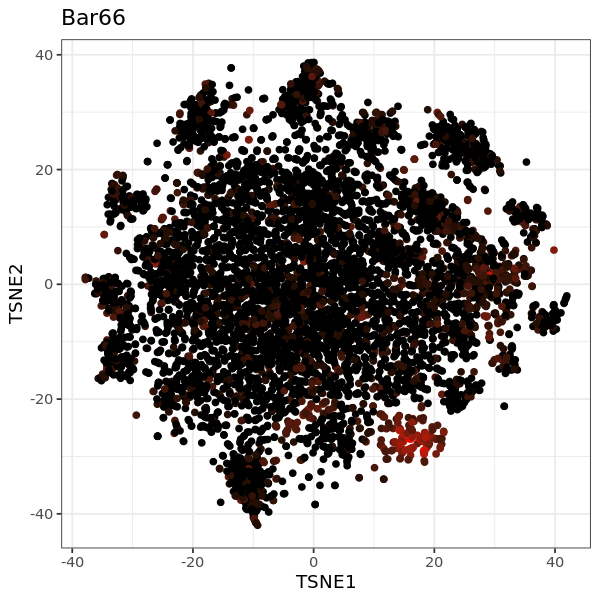

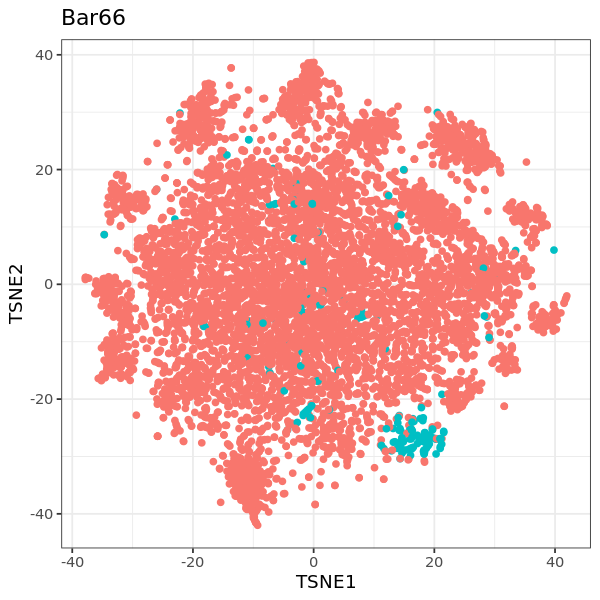

In [26]:
options(repr.plot.width=5, repr.plot.height=5)
bar.tsne$MULTI_class_rescued <- final.calls.rescued[rownames(bar.tsne)]
for (i in 3:(ncol(bar.tsne)-3)) {
    p <- ggplot(bar.tsne, aes(x = TSNE1, y = TSNE2, color = bar.tsne[,i])) +
        geom_point() +
        scale_color_gradient(low = "black", high = "red") +
        ggtitle(colnames(bar.tsne)[i]) +
        theme_bw() +
        theme(legend.position = "none") 
    print(p)
    p <- ggplot(bar.tsne, aes(x = TSNE1, y = TSNE2, color = MULTI_class_rescued == colnames(bar.tsne)[i])) +
        geom_point() +
        ggtitle(colnames(bar.tsne)[i]) +
        theme_bw() +
        theme(legend.position = "none") 
    print(p)
}

`summarise()` has grouped output by 'MULTI_class'. You can override using the `.groups` argument.

`summarise()` has grouped output by 'MULTI_class'. You can override using the `.groups` argument.



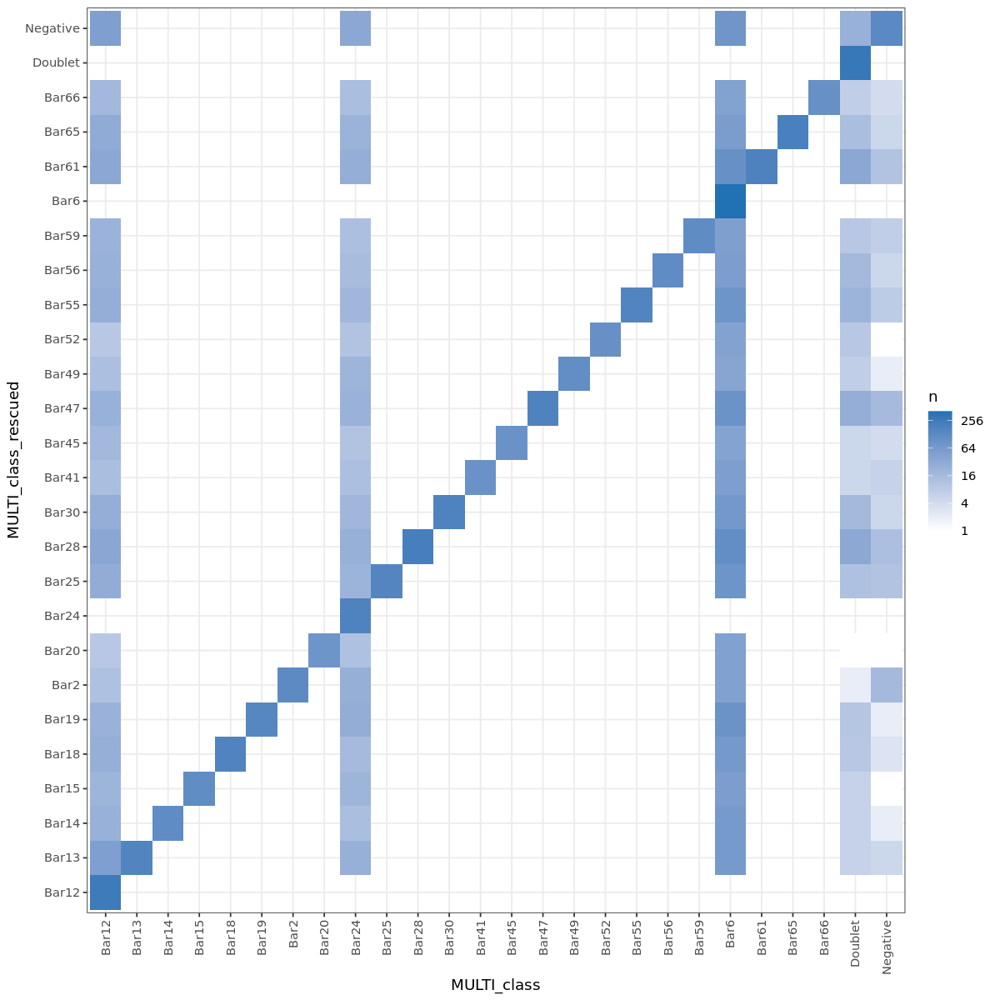

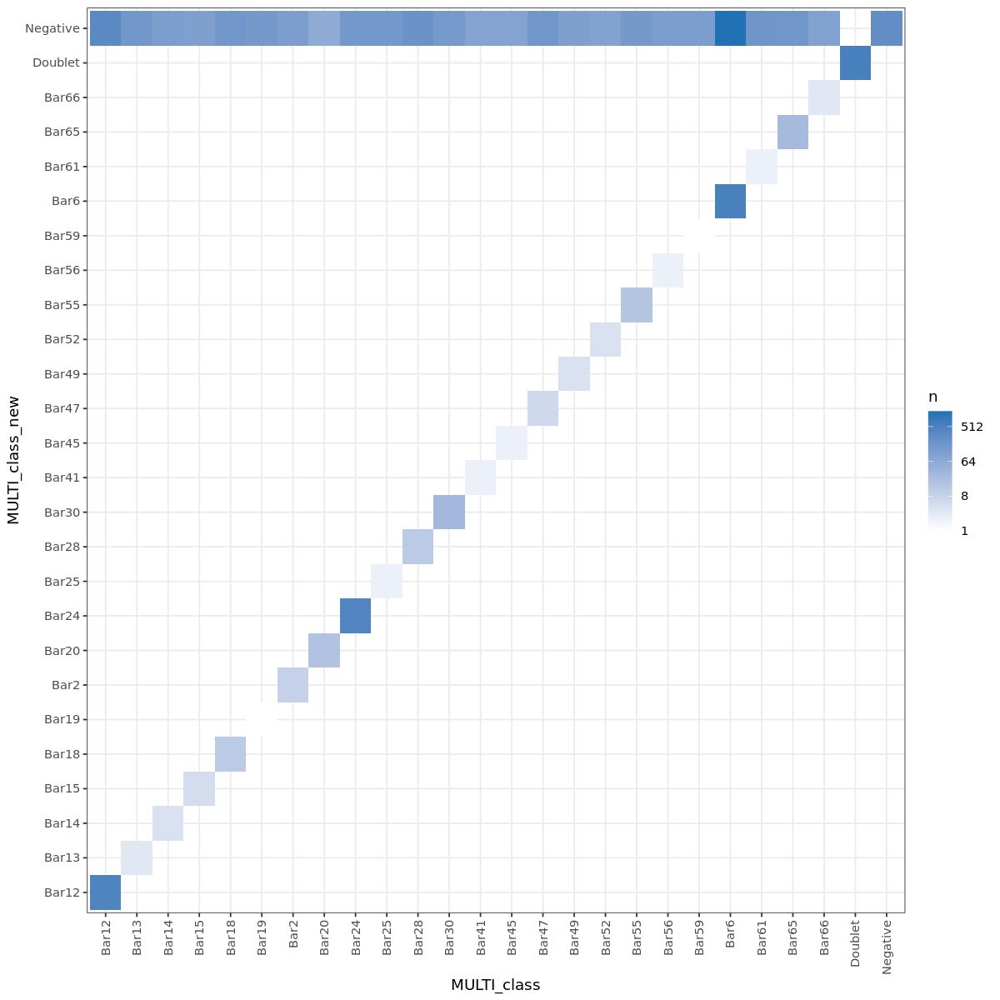

In [27]:
options(repr.plot.width=10, repr.plot.height=10)
to.plot <- bar.tsne %>%
    group_by(MULTI_class, MULTI_class_rescued) %>%
    summarise(n=n())
p <- ggplot(to.plot, aes(MULTI_class, MULTI_class_rescued, fill= n)) + 
  geom_tile() +
  #scale_fill_gradient( trans = 'log2' ) +
  scale_fill_gradient(low="white", high="#2171b5", trans = 'log2') +
  #scale_fill_continuous(type = "viridis", trans = 'log2') +
  theme_bw() +
    theme(axis.text.x = element_text(angle = 90, vjust = 0.5, hjust=1))
print(p)

to.plot <- bar.tsne %>%
    group_by(MULTI_class, MULTI_class_new) %>%
    summarise(n=n())
p <- ggplot(to.plot, aes(MULTI_class, MULTI_class_new, fill= n)) + 
  geom_tile() +
  #scale_fill_gradient( trans = 'log2' ) +
  scale_fill_gradient(low="white", high="#2171b5", trans = 'log2') +
  #scale_fill_continuous(type = "viridis", trans = 'log2') +
  theme_bw() +
    theme(axis.text.x = element_text(angle = 90, vjust = 0.5, hjust=1))
print(p)

Warning message:
“Transformation introduced infinite values in discrete y-axis”
Warning message:
“Transformation introduced infinite values in discrete y-axis”


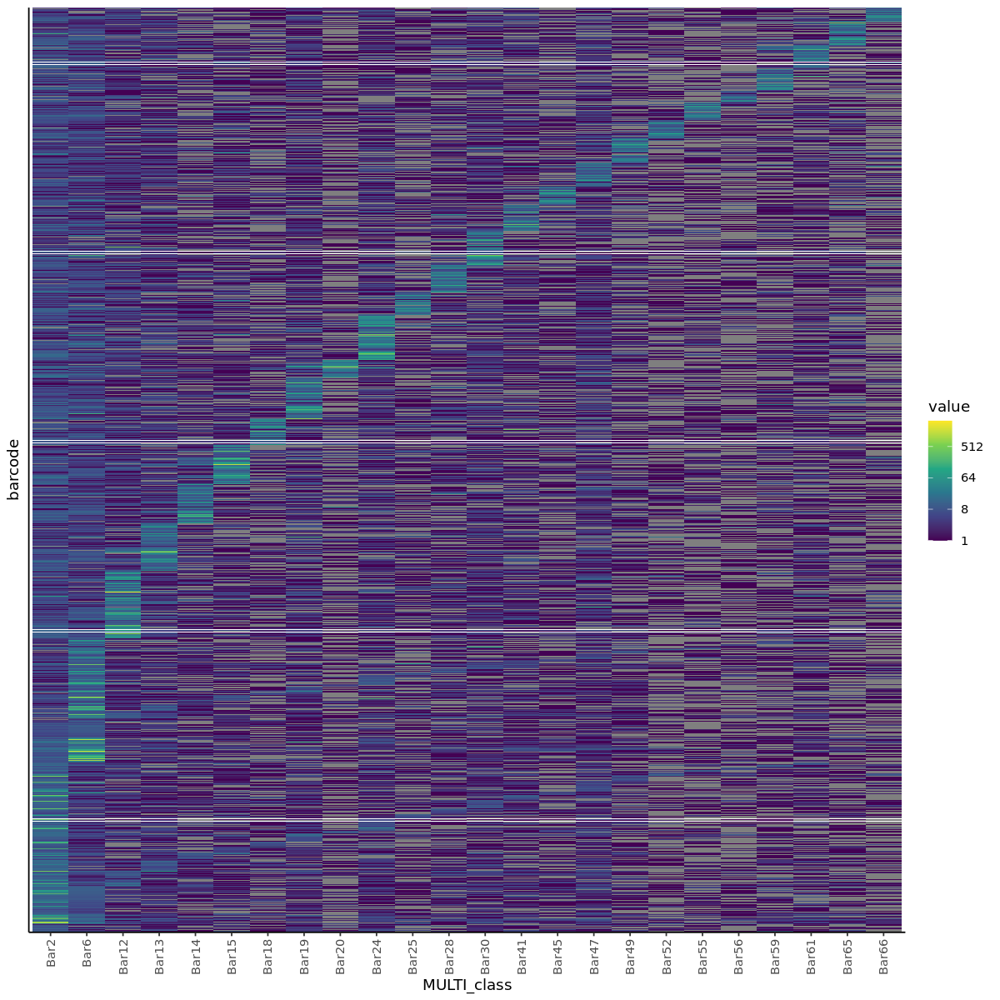

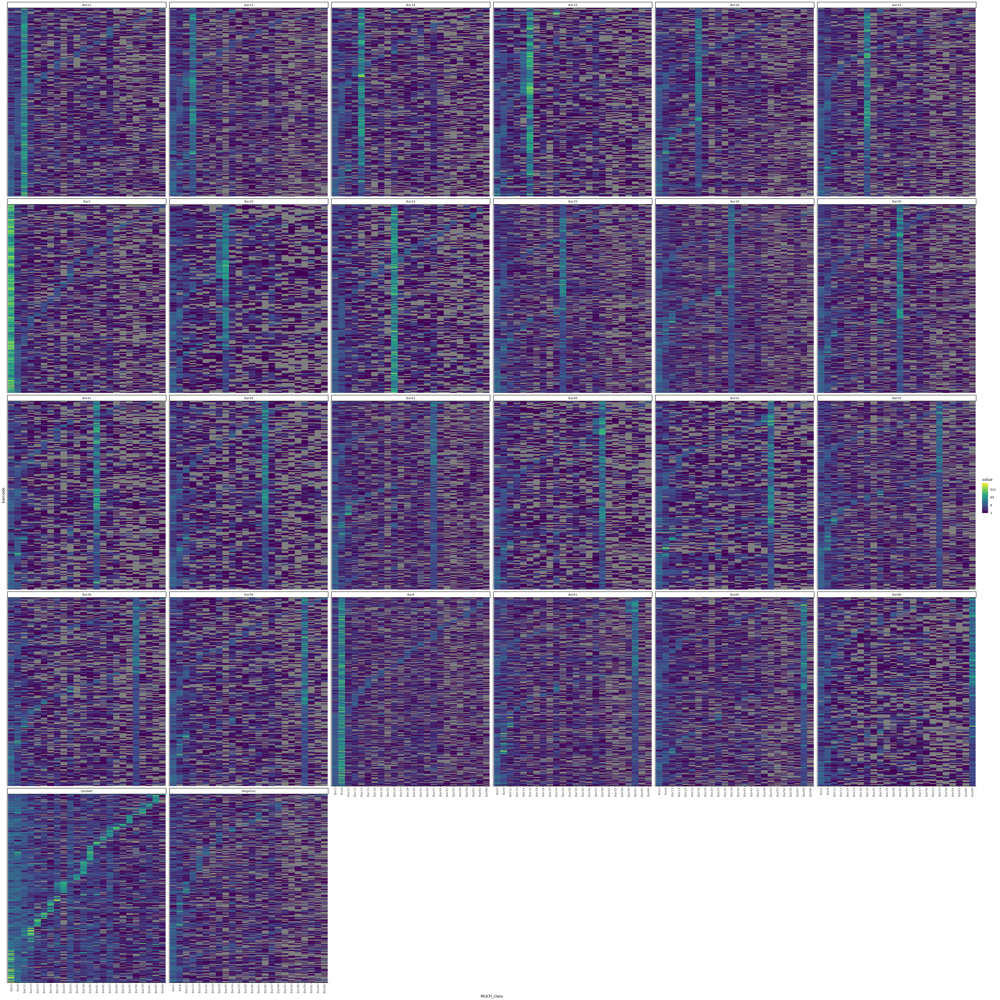

In [28]:
bar.table.hm <- bar.table.full[names(final.calls.rescued),good.bars]
bar.table.hm <- data.table(bar.table.hm)
rownames(bar.table.hm) <- names(final.calls.rescued)

argmax <- max.col(bar.table.hm)
bar.table.hm.sorted <- bar.table.hm[sort(argmax, index.return=TRUE)$ix,]
rownames(bar.table.hm.sorted) <- rownames(bar.table.hm)[sort(argmax, index.return=TRUE)$ix]
argmax2 <- max.col(replace(as.matrix(bar.table.hm.sorted), cbind(1:dim(bar.table.hm.sorted)[1], max.col(as.matrix(bar.table.hm.sorted))), -Inf))

sorted_argmax <- max.col(bar.table.hm.sorted)
rns <- rownames(bar.table.hm.sorted)
for (i in unique(argmax)) {
    bar.table.hm.sorted[sorted_argmax==i,] = bar.table.hm.sorted[sorted_argmax==i,][sort(argmax2[sorted_argmax==i], index.return=TRUE)$ix,]
    
    rns[sorted_argmax==i] <- rns[sorted_argmax==i][sort(argmax2[sorted_argmax==i], index.return=TRUE)$ix]
}
bar.table.hm.sorted <- as.matrix(bar.table.hm.sorted)
rownames(bar.table.hm.sorted) <- rns

to.plot <- melt(bar.table.hm.sorted, varnames = c("barcode", "MULTI_class"))
to.plot$final_call <- unname(final.calls.rescued[as.character(to.plot$barcode)])

options(repr.plot.width=10, repr.plot.height=10)
p <- ggplot(to.plot, aes(MULTI_class, barcode, fill= value)) + 
  geom_tile() +
  #scale_fill_gradient( trans = 'log2' ) +
  #scale_fill_gradient(low="white", high="#2171b5", trans = 'log2')
  scale_fill_continuous(type = "viridis", trans = 'log2') +
  theme_classic() +
  theme(axis.text.y=element_blank(),
        axis.ticks.y=element_blank(),
        axis.text.x = element_text(angle = 90, vjust = 0.5, hjust=1))
print(p)

options(repr.plot.width=40, repr.plot.height=40)
p <- ggplot(to.plot, aes(MULTI_class, barcode, fill= value)) + 
  geom_tile() +
  #scale_fill_gradient( trans = 'log2' ) +
  #scale_fill_gradient(low="white", high="#2171b5", trans = 'log2')
  scale_fill_continuous(type = "viridis", trans = 'log2') +
  theme_classic() +
  theme(axis.text.y=element_blank(),
        axis.ticks.y=element_blank(),
        axis.text.x = element_text(angle = 90, vjust = 0.5, hjust=1)) +
  facet_wrap(~final_call, scales = "free_y")
print(p)

In [49]:
suppressPackageStartupMessages(library(data.table))
suppressPackageStartupMessages(library(ggplot2))
suppressPackageStartupMessages(library(dplyr))
suppressPackageStartupMessages(library(ggalluvial))
suppressPackageStartupMessages(library(ggrepel))
library(gtools)
library(ggsignif)
source("/nfs/research/marioni/Leah/gastrulation_epigenetics/gastruloid_characterisation/gastruloids_scRNAseq/plotting_settings.R")

In [50]:
g_meta <- fread('/nfs/research/marioni/Leah/gastrulation_epigenetics/gastruloid_characterisation/data_dir/processed_files_Leah/scRNAseq/plot_df_joined.txt.gz')
g_meta[MULTI_class %in% as.vector(unlist(neural)), gastr_type := "neural"]
g_meta[MULTI_class %in% as.vector(unlist(meso)), gastr_type := "meso"]
g_meta[MULTI_class %in% as.vector(unlist(intermediate)), gastr_type := "intermediate"]

g_meta <- g_meta[batch == 'exp4_d3_sampleA']

In [51]:
MULTI_class1 <- final.calls
names(MULTI_class1) <- paste0(names(MULTI_class1), '-1')

MULTI_class2 <- final.calls2
names(MULTI_class2) <- paste0(names(MULTI_class2), '-1')

MULTI_class3 <- final.calls.rescued
names(MULTI_class3) <- paste0(names(MULTI_class3), '-1')

g_meta$MULTI_class1 <- unname(MULTI_class1[g_meta$barcode])
g_meta$MULTI_class2 <- unname(MULTI_class2[g_meta$barcode])
g_meta$MULTI_class3 <- unname(MULTI_class3[g_meta$barcode])

g_meta[paste0(MULTI_class3, '_exp4_d3') %in% as.vector(unlist(neural)), gastr_type3 := "neural"]
g_meta[paste0(MULTI_class3, '_exp4_d3') %in% as.vector(unlist(meso)), gastr_type3 := "meso"]
g_meta[paste0(MULTI_class3, '_exp4_d3') %in% as.vector(unlist(intermediate)), gastr_type3 := "intermediate"]
g_meta[MULTI_class3 %in% c("Negative", "Doublet"), gastr_type3 := MULTI_class3]
#g_meta[MULTI_class3 == 'Bar18', gastr_type3 := "meso"]

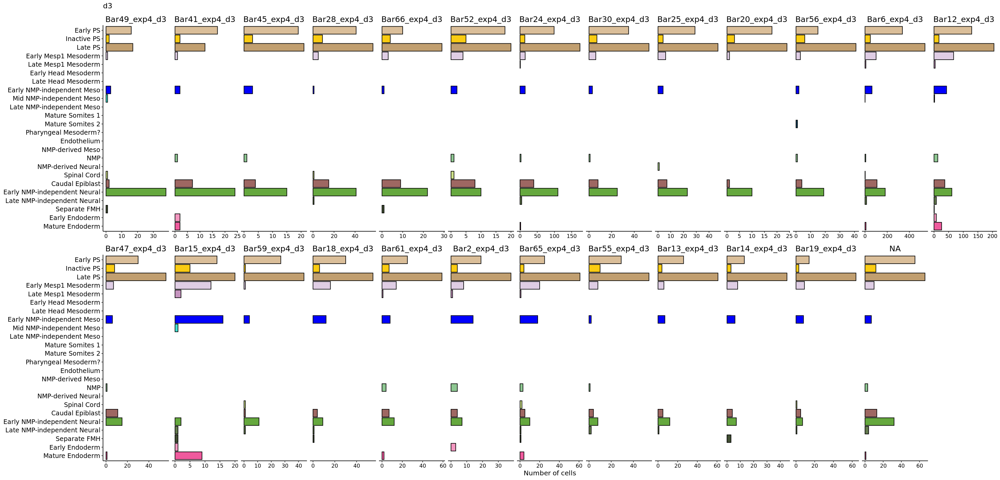

In [52]:
gastr_order_long <- c("Bar49_exp4_d3", "Bar41_exp4_d3", "Bar45_exp4_d3", "Bar28_exp4_d3", "Bar66_exp4_d3",
                 "Bar52_exp4_d3", "Bar24_exp4_d3", "Bar30_exp4_d3", "Bar25_exp4_d3", "Bar20_exp4_d3",
                 "Bar56_exp4_d3", "Bar6_exp4_d3", "Bar12_exp4_d3", "Bar47_exp4_d3", "Bar15_exp4_d3",
                 "Bar59_exp4_d3", "Bar18_exp4_d3", "Bar61_exp4_d3", "Bar2_exp4_d3", "Bar65_exp4_d3",
                 "Bar55_exp4_d3", "Bar13_exp4_d3", "Bar14_exp4_d3", "Bar19_exp4_d3"
 )

options(repr.plot.width=25, repr.plot.height=12)
to.plot <- g_meta[,.N,by=c("cluster","MULTI_class")]
to.plot$MULTI_class = factor(to.plot$MULTI_class, levels=gastr_order_long)
to.plot$cluster = factor(to.plot$cluster, levels=rev(cluster_order))
p <- barplot.pub(to.plot[!is.na(cluster)], x="cluster", colors=cluster_colours) +
  facet_wrap(~MULTI_class, nrow=2, scales="free_x") +
  ggtitle('d3')
print(p)

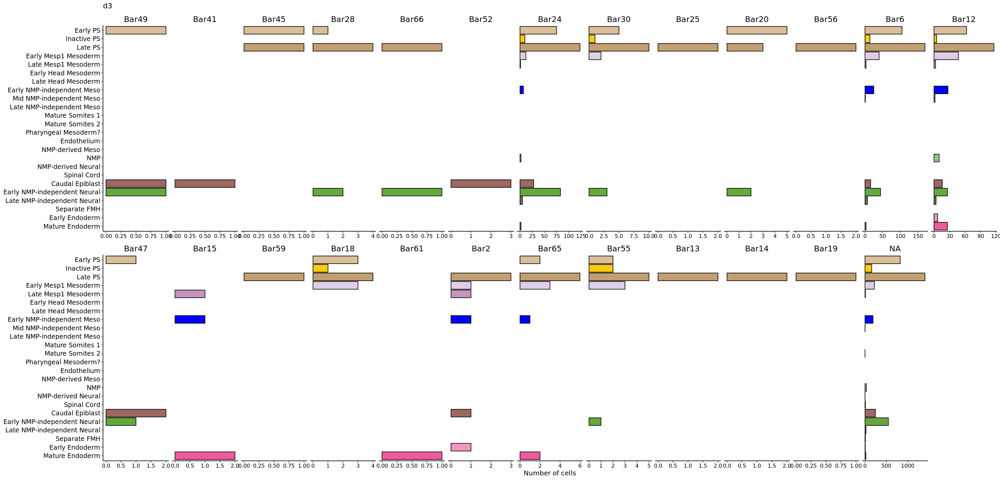

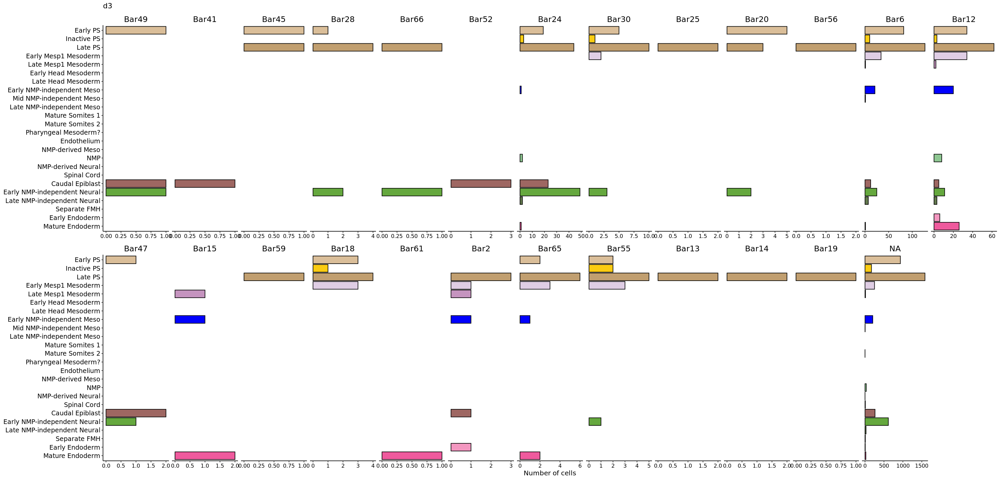

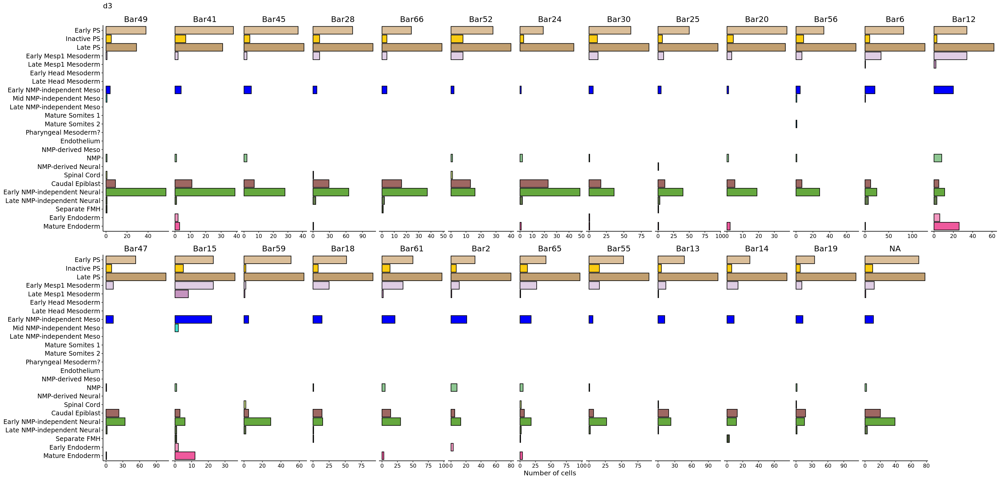

In [53]:
gastr_order_short <- c("Bar49", "Bar41", "Bar45", "Bar28", "Bar66", "Bar52", "Bar24", "Bar30", "Bar25",
                 "Bar20", "Bar56", "Bar6", "Bar12", "Bar47", "Bar15", "Bar59", "Bar18", "Bar61",
                 "Bar2", "Bar65", "Bar55", "Bar13", "Bar14", "Bar19"
                )

options(repr.plot.width=25, repr.plot.height=12)
to.plot <- g_meta[,.N,by=c("cluster","MULTI_class1")]
to.plot$MULTI_class1 = factor(to.plot$MULTI_class1, levels=gastr_order_short)
to.plot$cluster = factor(to.plot$cluster, levels=rev(cluster_order))
p <- barplot.pub(to.plot[!is.na(cluster)], x="cluster", colors=cluster_colours) +
  facet_wrap(~MULTI_class1, nrow=2, scales="free_x") +
  ggtitle('d3')
print(p)

to.plot <- g_meta[,.N,by=c("cluster","MULTI_class2")]
to.plot$MULTI_class2 = factor(to.plot$MULTI_class2, levels=gastr_order_short)
to.plot$cluster = factor(to.plot$cluster, levels=rev(cluster_order))
p <- barplot.pub(to.plot[!is.na(cluster)], x="cluster", colors=cluster_colours) +
  facet_wrap(~MULTI_class2, nrow=2, scales="free_x") +
  ggtitle('d3')
print(p)

to.plot <- g_meta[,.N,by=c("cluster","MULTI_class3")]
to.plot$MULTI_class3 = factor(to.plot$MULTI_class3, levels=gastr_order_short)
to.plot$cluster = factor(to.plot$cluster, levels=rev(cluster_order))
p <- barplot.pub(to.plot[!is.na(cluster)], x="cluster", colors=cluster_colours) +
  facet_wrap(~MULTI_class3, nrow=2, scales="free_x") +
  ggtitle('d3')
print(p)

In [54]:
g_meta[!(MULTI_class %in% c('Doublet', 'Negative')),MULTI_agree := MULTI_class == paste0(MULTI_class3, '_exp4_d3')]
g_meta[(MULTI_class %in% c('Doublet', 'Negative')),MULTI_agree := MULTI_class == MULTI_class3]

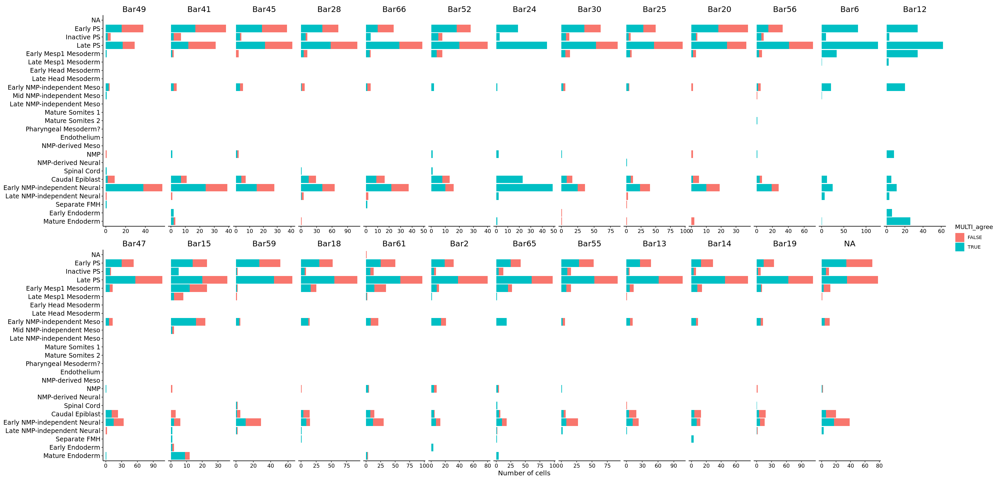

Warning message in `[.data.table`(g_meta[, `:=`(sum, .N), by = c("MULTI_class3", :
“Column 'cell' does not exist to remove”
Warning message:
“Groups with fewer than two data points have been dropped.”
Warning message:
“Groups with fewer than two data points have been dropped.”
Warning message:
“Groups with fewer than two data points have been dropped.”
Warning message:
“Groups with fewer than two data points have been dropped.”
Warning message:
“Groups with fewer than two data points have been dropped.”
Warning message:
“Groups with fewer than two data points have been dropped.”
Warning message:
“Groups with fewer than two data points have been dropped.”


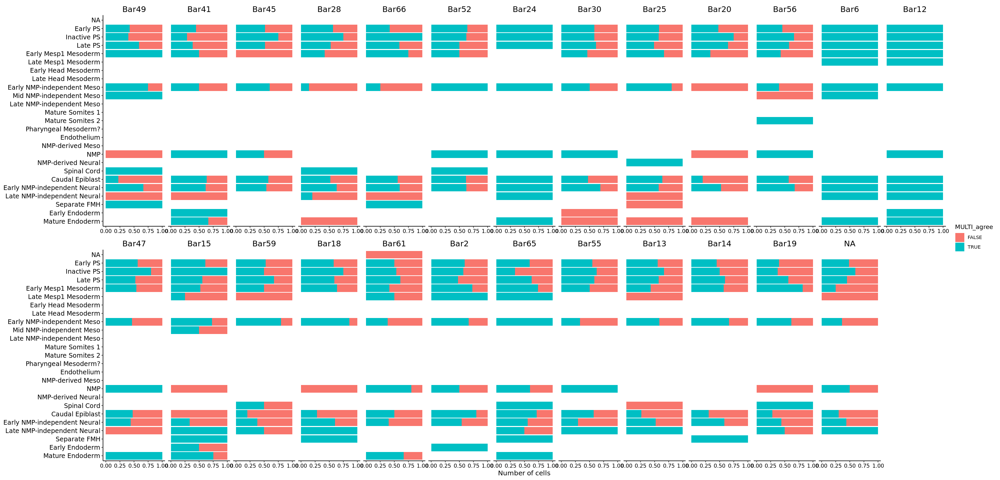

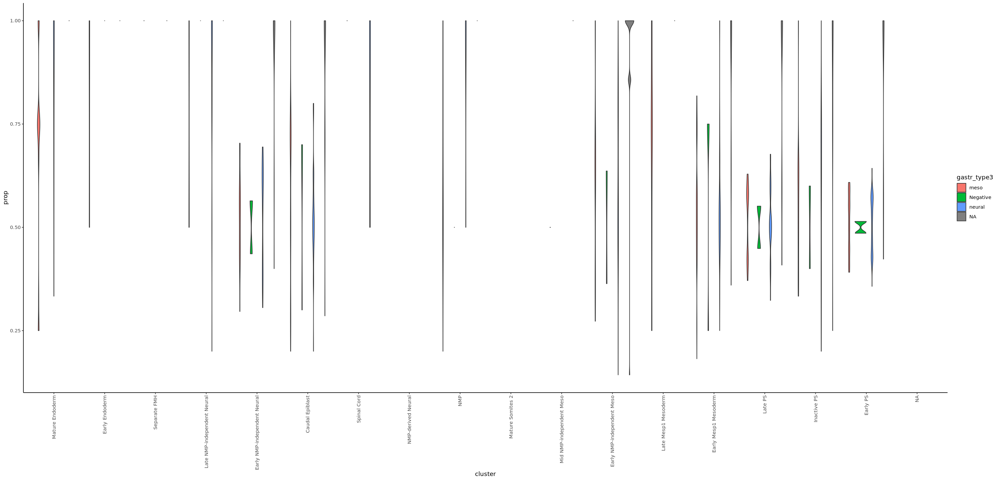

In [58]:
to.plot <- g_meta[,.N,by=c("cluster", "MULTI_class3", "MULTI_agree")]
to.plot$MULTI_class3 = factor(to.plot$MULTI_class3, levels=gastr_order_short)
to.plot$cluster = factor(to.plot$cluster, levels=rev(cluster_order))
p <- ggplot(to.plot, aes(x = cluster, y = N)) + scale_x_discrete(drop = FALSE) + 
    labs(y = "Number of cells") +
    theme_classic() +
    theme(strip.background = element_blank(),
          strip.text = element_text(color = "black", size = rel(1.3)),
          axis.title.x = element_text(color = "black", size = rel(1.1)),
          axis.title.y = element_blank(), 
          axis.text.y = element_text(size = rel(1.3), color = "black"), 
          axis.text.x = element_text(size = rel(1.1), color = "black")) +
    geom_bar(stat = "identity", aes(fill = MULTI_agree)) +
    coord_flip() +
    facet_wrap(~MULTI_class3, nrow=2, scales="free_x")
print(p)
p <- ggplot(to.plot, aes(x = cluster, y = N)) + scale_x_discrete(drop = FALSE) + 
    labs(y = "Number of cells") +
    theme_classic() +
    theme(strip.background = element_blank(),
          strip.text = element_text(color = "black", size = rel(1.3)),
          axis.title.x = element_text(color = "black", size = rel(1.1)),
          axis.title.y = element_blank(), 
          axis.text.y = element_text(size = rel(1.3), color = "black"), 
          axis.text.x = element_text(size = rel(1.1), color = "black")) +
    geom_bar(stat = "identity", position="fill", aes(fill = MULTI_agree)) +
    coord_flip() +
    facet_wrap(~MULTI_class3, nrow=2, scales="free_x")
print(p)

to.plot <- g_meta[, sum := .N, by = c("MULTI_class3", "cluster", "gastr_type3")][, prop := .N, by = c("MULTI_class3", "cluster", "MULTI_agree", "gastr_type3")][, prop := prop/sum][, sum := NULL][,cell := NULL] %>% unique
to.plot$cluster = factor(to.plot$cluster, levels=rev(cluster_order))
p <- ggplot(to.plot, aes(x=cluster, y=prop, fill=gastr_type3)) +
  geom_violin() +
  #scale_fill_manual(values = gastr_type_colours, name = "Gastruloid Type") +
  #scale_y_continuous(trans='log2') +
  theme_classic() +
  theme(axis.text.x = element_text(angle = 90, vjust = 0.5, hjust=1))
print(p)

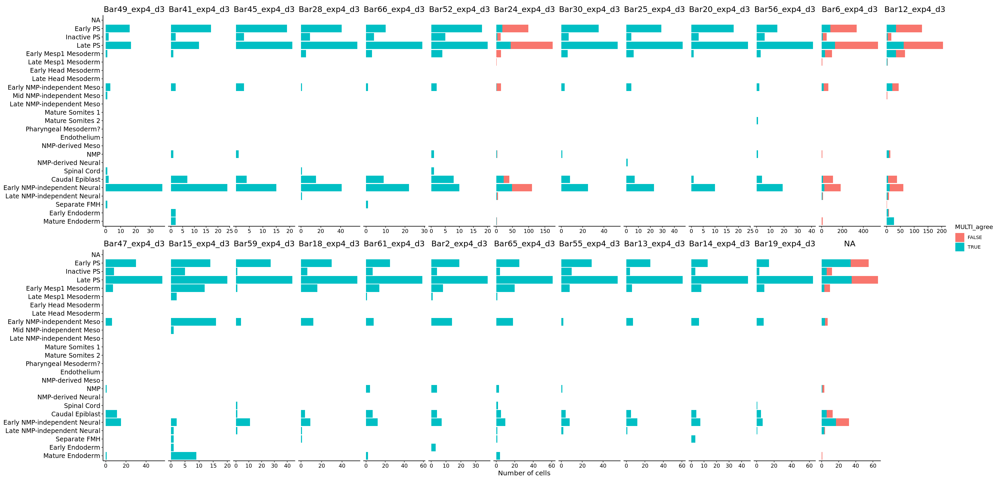

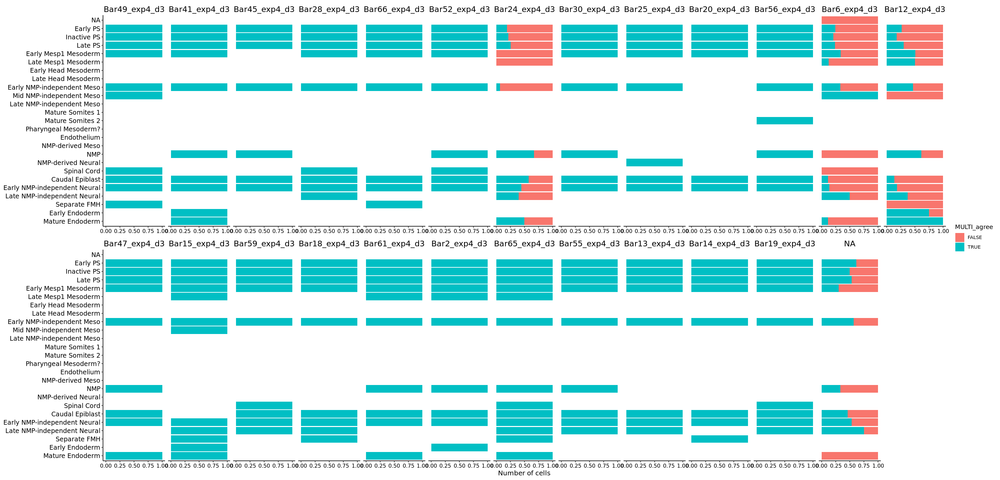

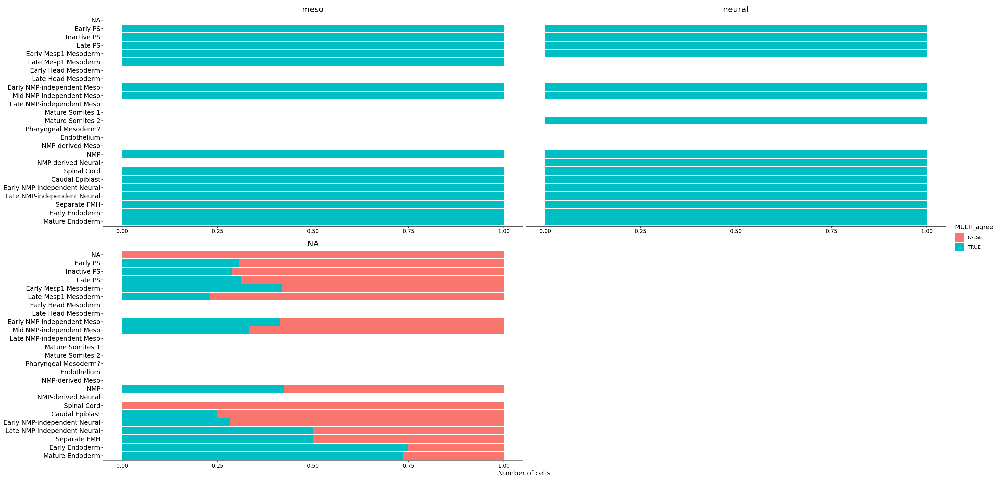

In [56]:
to.plot <- g_meta[,.N,by=c("cluster", "MULTI_class", "MULTI_agree")]
to.plot$MULTI_class = factor(to.plot$MULTI_class, levels=gastr_order_long)
to.plot$cluster = factor(to.plot$cluster, levels=rev(cluster_order))
p <- ggplot(to.plot, aes(x = cluster, y = N)) + scale_x_discrete(drop = FALSE) + 
    labs(y = "Number of cells") +
    theme_classic() +
    theme(strip.background = element_blank(),
          strip.text = element_text(color = "black", size = rel(1.3)),
          axis.title.x = element_text(color = "black", size = rel(1.1)),
          axis.title.y = element_blank(), 
          axis.text.y = element_text(size = rel(1.3), color = "black"), 
          axis.text.x = element_text(size = rel(1.1), color = "black")) +
    geom_bar(stat = "identity", aes(fill = MULTI_agree)) +
    coord_flip() +
    facet_wrap(~MULTI_class, nrow=2, scales="free_x")
print(p)

p <- ggplot(to.plot, aes(x = cluster, y = N)) + scale_x_discrete(drop = FALSE) + 
    labs(y = "Number of cells") +
    theme_classic() +
    theme(strip.background = element_blank(),
          strip.text = element_text(color = "black", size = rel(1.3)),
          axis.title.x = element_text(color = "black", size = rel(1.1)),
          axis.title.y = element_blank(), 
          axis.text.y = element_text(size = rel(1.3), color = "black"), 
          axis.text.x = element_text(size = rel(1.1), color = "black")) +
    geom_bar(stat = "identity", position="fill", aes(fill = MULTI_agree)) +
    coord_flip() +
    facet_wrap(~MULTI_class, nrow=2, scales="free_x")
print(p)

to.plot <- g_meta[,.N,by=c("cluster", "gastr_type", "MULTI_agree")]
to.plot$cluster = factor(to.plot$cluster, levels=rev(cluster_order))
p <- ggplot(to.plot, aes(x = cluster, y = N)) + scale_x_discrete(drop = FALSE) + 
    labs(y = "Number of cells") +
    theme_classic() +
    theme(strip.background = element_blank(),
          strip.text = element_text(color = "black", size = rel(1.3)),
          axis.title.x = element_text(color = "black", size = rel(1.1)),
          axis.title.y = element_blank(), 
          axis.text.y = element_text(size = rel(1.3), color = "black"), 
          axis.text.x = element_text(size = rel(1.1), color = "black")) +
    geom_bar(stat = "identity", position="fill", aes(fill = MULTI_agree)) +
    coord_flip() +
    facet_wrap(~gastr_type, nrow=2, scales="free_x")
print(p)